# Pancreatic endocrinogenesis

In [1]:
import random
import numpy as np

# seed = 0
# # torch.manual_seed(seed)
# random.seed(seed)
# np.random.seed(seed)

In [2]:
import warnings
warnings.filterwarnings('ignore')

import dynamo as dyn 

|-----> setting visualization default mode in dynamo. Your customized matplotlib settings might be overritten.


In [3]:
dyn.get_all_dependencies_version()


KeyError: 'dynamo-release'

In [3]:
# run dynamo to get RNA velocity 
dyn.configuration.set_figure_params('dynamo', background='white')
adata = dyn.sample_data.pancreatic_endocrinogenesis()

|-----> Downloading data to ./data/endocrinogenesis_day15.h5ad


In [4]:
pancreas_genes = [
    "Hes1",
    "Nkx6-1",
    "Nkx2-2",
    "Neurog3",
    "Neurod1",
    "Pax4",
    "Pax6",
    "Arx",
    "Pdx1",
    "Ins1",
    "Ins2",
    "Ghrl",
    "Ptf1a",
    "Iapp",
    "Isl1",
    "Sox9",
    "Gcg",
]

dyn.pp.recipe_monocle(adata, n_top_genes=4000, fg_kwargs={"shared_count": 20}, genes_to_append=pancreas_genes)

|-----> recipe_monocle_keep_filtered_cells_key is None. Using default value from DynamoAdataConfig: recipe_monocle_keep_filtered_cells_key=True
|-----> recipe_monocle_keep_filtered_genes_key is None. Using default value from DynamoAdataConfig: recipe_monocle_keep_filtered_genes_key=True
|-----> recipe_monocle_keep_raw_layers_key is None. Using default value from DynamoAdataConfig: recipe_monocle_keep_raw_layers_key=True
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['

In [5]:
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'log_m', 'score', 'frac', 'use_for_pca', 'ntr'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'cell_phase_genes'
    obsm: 'X_pca', 'X_umap', 'X', 'cell_cycle_scores'
    layers: 'spliced', 'unspliced', 'X_spliced', 'X_unspliced'
    obsp: 'distances', 'connectivities'

In [6]:
dyn.tl.dynamics(adata, model='static')

|-----> dynamics_del_2nd_moments_key is None. Using default value from DynamoAdataConfig: dynamics_del_2nd_moments_key=False
|-----------> removing existing M layers:[]...
|-----------> making adata smooth...
|-----> calculating first/second moments...
|-----> [moments calculation] in progress: 100.0000%
|-----> [moments calculation] finished [18.4828s]


AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'log_m', 'score', 'frac', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'neighbors', 'pca', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'cell_phase_genes', 'dynamics'
    obsm: 'X_pca', 'X_umap', 'X', 'cell_cycle_scores'
    layers: 'spliced', 'unspliced', 'X_spliced', 'X_unspliced

<br><br><br>
## Inputting ds/dt from cellDancer to dynamo.

In [7]:
import pandas as pd 
import numpy as np
import scipy

dancer_df = pd.read_csv('/Users/shengyuli/Library/CloudStorage/OneDrive-HoustonMethodist/work/Velocity/bin/cellDancer_polish/analysis/CaseStudyNotebook/your_path/PancreaticEndocrinogenesis_cellDancer_estimation.csv')

In [8]:
dancer_genes = dancer_df['gene_name'].drop_duplicates()

In [9]:
dancer_df["velocity_S"] = dancer_df["splice_predict"]-dancer_df["splice"]
dancer_velocity_s = dancer_df[['cellID', 'gene_name', 'velocity_S']]
pivoted = dancer_velocity_s.pivot(index="cellID", columns="gene_name", values="velocity_S")
velocity_matrix = np.zeros(adata.shape)
adata_ds_zeros = pd.DataFrame(velocity_matrix, columns=adata.var.index, index=adata.obs.index)
celldancer_velocity_s_df = (adata_ds_zeros + pivoted).fillna(0)[adata.var.index]


In [10]:
adata.layers['velocity_S'] = scipy.sparse.csr_matrix(celldancer_velocity_s_df.values)

In [11]:
adata.var['use_for_dynamics'] = adata.var.index.isin(dancer_genes)
adata.var['use_for_transition'] = adata.var.index.isin(dancer_genes)

In [12]:
# import celldancer.cdplt as cdplt
# pancreas_cluster_cmap = cdplt.colormap.colormap_pancreas
pancreas_cluster_cmap = {'Ductal': '#3361A5',
 'Ngn3 low EP': '#248AF3',
 'Ngn3 high EP': '#14B3FF',
 'Pre-endocrine': '#88CEEF',
 'Alpha': '#ff4800',
 'Beta': '#B81136',
 'Delta': 'green',
 'Epsilon': '#03B3B0'}

|-----> retrive data for non-linear dimension reduction...
|-----? adata already have basis umap. dimension reduction umap will be skipped! 
set enforce=True to re-performing dimension reduction.
|-----> [dimension_reduction projection] in progress: 100.0000%
|-----> [dimension_reduction projection] finished [0.0029s]
|-----> 0 genes are removed because of nan velocity values.
|-----> [calculating transition matrix via pearson kernel with sqrt transform.] in progress: 100.0000%
|-----> [calculating transition matrix via pearson kernel with sqrt transform.] finished [14.6748s]
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [1.0454s]
|-----> 0 genes are removed because of nan velocity values.
Using existing pearson_transition_matrix found in .obsp.
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector t

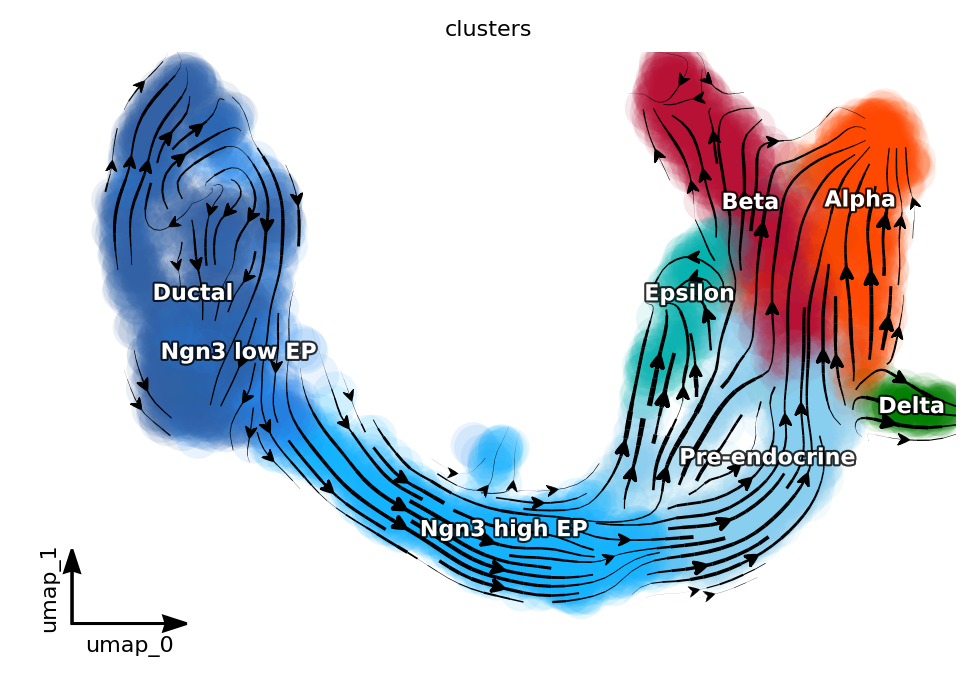

In [13]:
dyn.tl.reduceDimension(adata, n_pca_components=30)
dyn.tl.cell_velocities(adata, method="pearson", other_kernels_dict={"transform": "sqrt"})
dyn.tl.cell_velocities(adata, basis="pca")

dyn.pl.streamline_plot(adata, color=["clusters"], basis="umap", color_key = pancreas_cluster_cmap, show_legend="on data", show_arrowed_spines=True)

In [14]:
dyn.vf.VectorField(adata, basis="pca", pot_curl_div=True)
dyn.vf.VectorField(adata, basis="umap", pot_curl_div=True)

dyn.vf.speed(adata, basis="pca")
dyn.vf.divergence(adata, basis="pca")
dyn.vf.acceleration(adata, basis="pca")
dyn.vf.curl(adata, basis="umap")

|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [0.4309s]
|-----> <insert> velocity_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_pca to uns in AnnData Object.
|-----> Running ddhodge to estimate vector field based pseudotime in pca basis...
|-----> graphizing vectorfield...
|-----> incomplete neighbor graph info detected: connectivities and distances do not exist in adata.obsp, indices not in adata.uns.neighbors.
|-----> Neighbor graph is broken, recomputing....
|-----> Start computing neighbor graph...
|-----------> X_data is None, fetching or recomputing...
|-----> fetching X data from la

Calculating divergence: 100%|█████████████████████| 4/4 [00:00<00:00,  9.02it/s]


|-----> <insert> control_point_pca to obs in AnnData Object.
|-----> <insert> inlier_prob_pca to obs in AnnData Object.
|-----> <insert> obs_vf_angle_pca to obs in AnnData Object.
|-----> [VectorField] in progress: 100.0000%
|-----> [VectorField] finished [22.2679s]
|-----> VectorField reconstruction begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [0.4616s]
|-----> <insert> velocity_umap_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_umap_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_umap to uns in AnnData Object.
|-----> Running ddhodge to estimate vector field based pseudotime in umap basis...
|-----> gr

Calculating 2-D curl: 100%|██████████████| 3696/3696 [00:00<00:00, 16062.94it/s]

|-----> Computing divergence...



Calculating divergence: 100%|█████████████████████| 4/4 [00:00<00:00, 23.15it/s]

|-----> <insert> control_point_umap to obs in AnnData Object.
|-----> <insert> inlier_prob_umap to obs in AnnData Object.


|-----> <insert> obs_vf_angle_umap to obs in AnnData Object.
|-----> [VectorField] in progress: 100.0000%
|-----> [VectorField] finished [20.4547s]


Calculating divergence: 100%|█████████████████████| 4/4 [00:00<00:00,  9.54it/s]


|-----> [Calculating acceleration] in progress: 100.0000%
|-----> [Calculating acceleration] finished [0.1717s]
|-----> <insert> acceleration to layers in AnnData Object.


Calculating 2-D curl: 100%|██████████████| 3696/3696 [00:00<00:00, 17985.39it/s]


|-----> Vector field for umap is but its topography is not mapped. Mapping topography now ...
|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


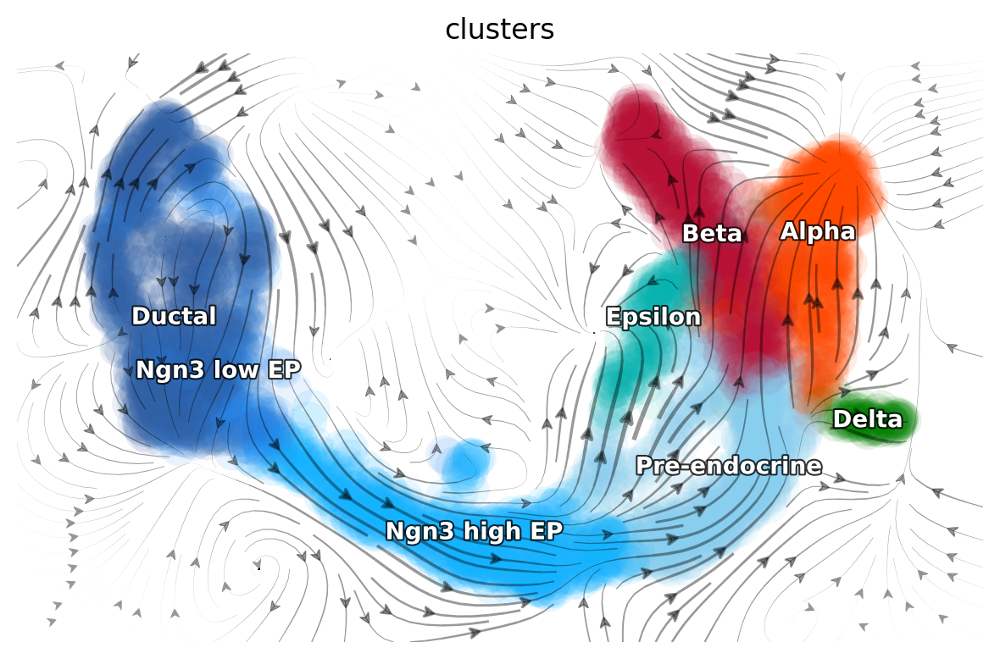

In [15]:
dyn.pl.topography(adata, color=['clusters'], basis='umap', background='white', 
                  streamline_color='black', color_key = pancreas_cluster_cmap, show_legend='on data', terms=("streamline"))

|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


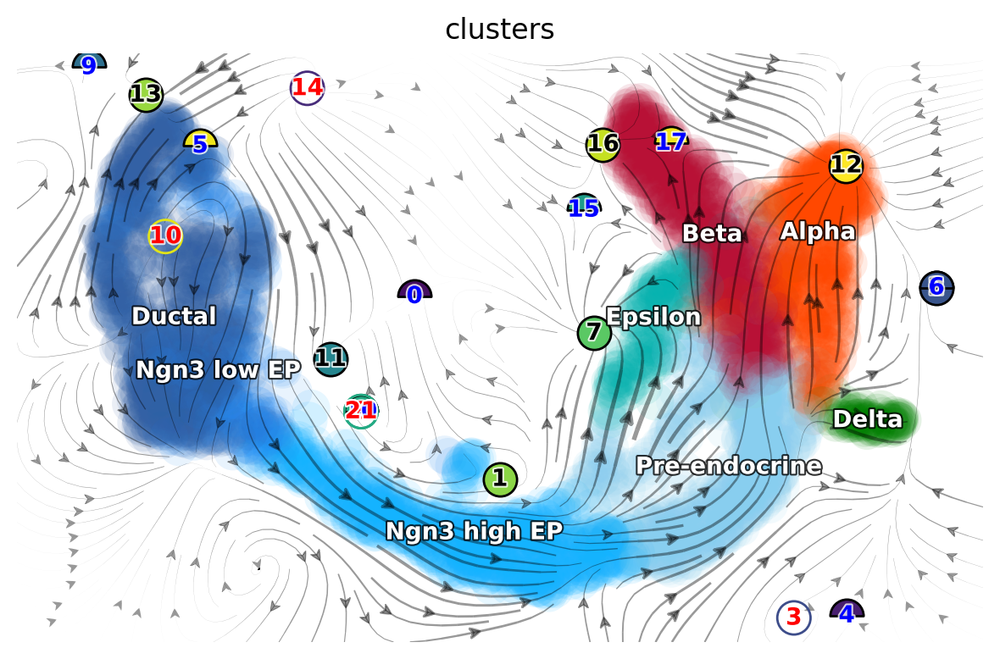

In [16]:
# color of digit: 
#   red --> repellor, 
#   black --> attractor, 
#   blue --> saddle point
# color in the cluster circle: 
#   lighter --> more confidence 
# 
dyn.pl.topography(adata, color=['clusters'], basis='umap', background='white', 
                  streamline_color='black', color_key = pancreas_cluster_cmap, show_legend='on data')

In [ ]:
adata_load_fix_points=adata_load.copy()
Xss, ftype, conf = adata.uns['VecFld_umap']['Xss'],\
             adata.uns['VecFld_umap']['ftype'],\
             adata.uns['VecFld_umap']['confidence']
    
good_fixed_points = [10,7,16,12] # n=750

adata_load_fix_points.uns['VecFld_umap']['Xss'] = Xss[good_fixed_points]
adata_load_fix_points.uns['VecFld_umap']['ftype'] = ftype[good_fixed_points]
adata_load_fix_points.uns['VecFld_umap']['confidence']=conf[good_fixed_points]

In [17]:
# cell type transition graph

from tkinter import font

dyn.pd.state_graph(adata, group='clusters', basis='umap', method='vf')

|-----> Estimating the transition probability between cell types...
|-----> Applying vector field
|-----> [KDTree computation] in progress: 100.0000%in progress: 0.0000%
|-----> [KDTree computation] finished [0.0036s]
|-----> [iterate groups] in progress: 12.5000%

integration with ivp solver: 100%|████████████| 100/100 [00:10<00:00,  9.78it/s]
uniformly sampling points along a trajectory: 100%|█| 100/100 [00:00<00:00, 233.


|-----> [iterate groups] in progress: 25.0000%

integration with ivp solver: 100%|████████████| 100/100 [00:16<00:00,  6.19it/s]
uniformly sampling points along a trajectory: 100%|█| 100/100 [00:00<00:00, 207.


|-----> [iterate groups] in progress: 37.5000%

integration with ivp solver: 100%|████████████| 100/100 [00:09<00:00, 10.81it/s]
uniformly sampling points along a trajectory: 100%|█| 100/100 [00:00<00:00, 247.


|-----> [iterate groups] in progress: 50.0000%

integration with ivp solver: 100%|████████████| 100/100 [00:09<00:00, 10.98it/s]
uniformly sampling points along a trajectory: 100%|█| 100/100 [00:00<00:00, 230.


|-----> [iterate groups] in progress: 62.5000%

integration with ivp solver: 100%|██████████████| 70/70 [00:06<00:00, 10.64it/s]
uniformly sampling points along a trajectory: 100%|█| 70/70 [00:00<00:00, 213.02


|-----> [iterate groups] in progress: 75.0000%

integration with ivp solver: 100%|████████████| 100/100 [00:10<00:00,  9.27it/s]
uniformly sampling points along a trajectory: 100%|█| 100/100 [00:00<00:00, 239.


|-----> [iterate groups] in progress: 87.5000%

integration with ivp solver: 100%|████████████| 100/100 [00:12<00:00,  8.26it/s]
uniformly sampling points along a trajectory: 100%|█| 100/100 [00:00<00:00, 207.


|-----> [iterate groups] in progress: 100.0000%

integration with ivp solver: 100%|████████████| 100/100 [00:10<00:00,  9.60it/s]
uniformly sampling points along a trajectory: 100%|█| 100/100 [00:00<00:00, 232.


|-----> [iterate groups] in progress: 100.0000%
|-----> [iterate groups] finished [91.5298s]
|-----> [State graph estimation] in progress: 100.0000%
|-----> [State graph estimation] finished [0.0021s]


AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'pca_ddhodge_div', 'pca_ddhodge_potential', 'divergence_pca', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'speed_pca', 'acceleration_pca'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'log_m', 'score', 'frac', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters

|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


<Figure size 640x480 with 0 Axes>

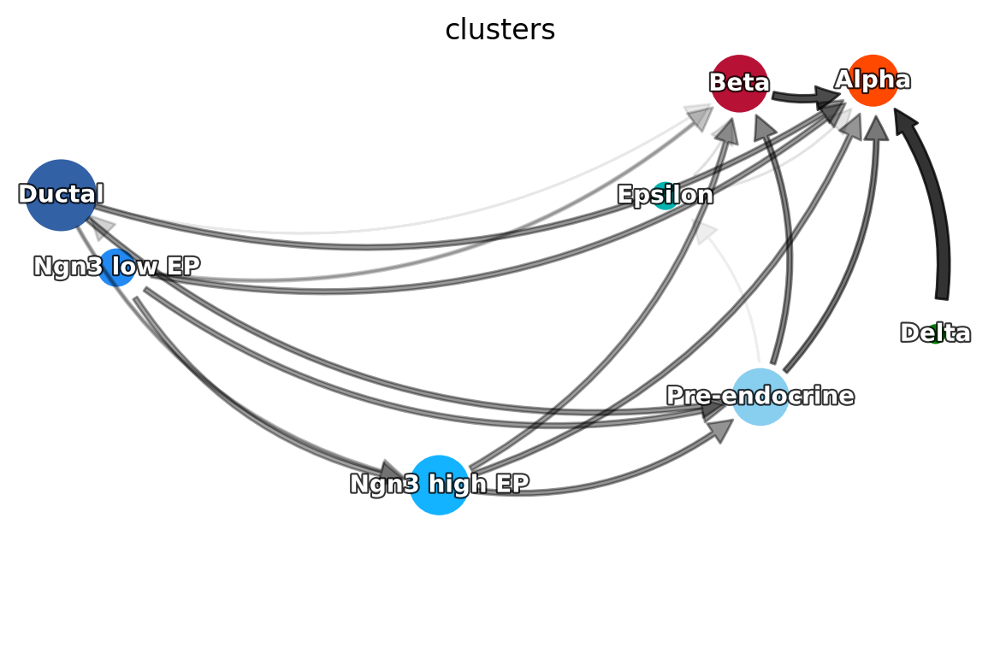

In [18]:
dyn.pl.state_graph(adata,
                   color=['clusters'],
                   color_key=pancreas_cluster_cmap,
                   group='clusters',
                   basis='umap',
                   show_legend='on data',
                   method='vf',
                   transition_threshold=0.05
                    )

## Computing Jacobian and reveal regulator/effector gene relations 

In [19]:
adata

AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'pca_ddhodge_div', 'pca_ddhodge_potential', 'divergence_pca', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'speed_pca', 'acceleration_pca'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'log_m', 'score', 'frac', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters

In [20]:
progenitor = adata.obs_names[adata.obs.clusters.isin(["Ductal"])]
pancreas_genes = [
    "Hes1",
    "Nkx6-1",
    "Nkx2-2",
    "Neurog3",
    "Neurod1",
    "Pax4",
    "Pax6",
    "Arx",
    "Pdx1",
    "Ins1",
    "Ins2",
    "Ghrl",
    "Ptf1a",
    "Iapp",
    "Isl1",
    "Sox9",
    "Gcg",
]


In [21]:
dyn.vf.jacobian(adata, regulators=pancreas_genes)

Transforming subset Jacobian: 100%|██████| 3696/3696 [00:00<00:00, 44864.71it/s]


AnnData object with n_obs × n_vars = 3696 × 27998
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'nGenes', 'nCounts', 'pMito', 'pass_basic_filter', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'pca_ddhodge_div', 'pca_ddhodge_potential', 'divergence_pca', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'umap_ddhodge_div', 'umap_ddhodge_potential', 'curl_umap', 'divergence_umap', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'speed_pca', 'acceleration_pca', 'jacobian_det_pca'
    var: 'highly_variable_genes', 'nCells', 'nCounts', 'pass_basic_filter', 'log_cv', 'log_m', 'score', 'frac', 'use_for_pca', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition

In [22]:
full_reg_rank = dyn.vf.rank_jacobian_genes(
    adata, groups="clusters", mode="full_reg", abs=True, output_values=True, return_df=True
)
full_eff_rank = dyn.vf.rank_jacobian_genes(
    adata, groups="clusters", mode="full_eff", abs=True, exclude_diagonal=True, output_values=True, return_df=True
)

### ductal

|-----> [iterating reg_groups] in progress: 100.0000%
|-----> [iterating reg_groups] finished [0.2654s]


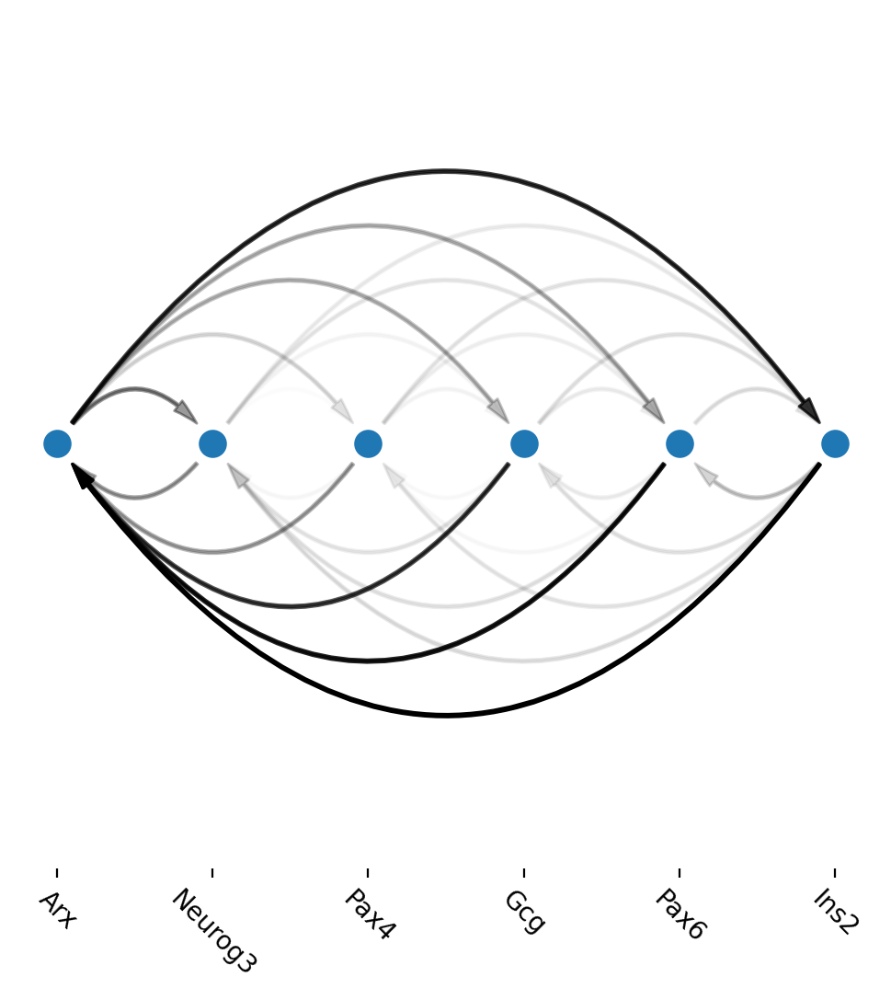

In [74]:
ductal_cell_type_regulators = ["Neurog3", "Arx", "Pax4", "Pax6", "Gcg", "Ins2", "Ss5", "Ghri"]

cell_type_regulators = ductal_cell_type_regulators

cluster2edges = dyn.vf.build_network_per_cluster(
    adata,
    cluster="clusters",
    cluster_names=None,
    full_reg_rank=full_reg_rank,
    full_eff_rank=full_eff_rank,
    genes=cell_type_regulators,
    n_top_genes=100,
)

import networkx as nx
# ductal
network = nx.from_pandas_edgelist(
    cluster2edges["Ductal"], "regulator", "target", edge_attr="weight", create_using=nx.DiGraph()
)
ax = dyn.pl.arcPlot(
    adata, cluster="clusters", cluster_name="Ductal", edges_list=None, network=network, color=None
)  # color="M_s")


regulator: Arx effector: Ins2 arrow True


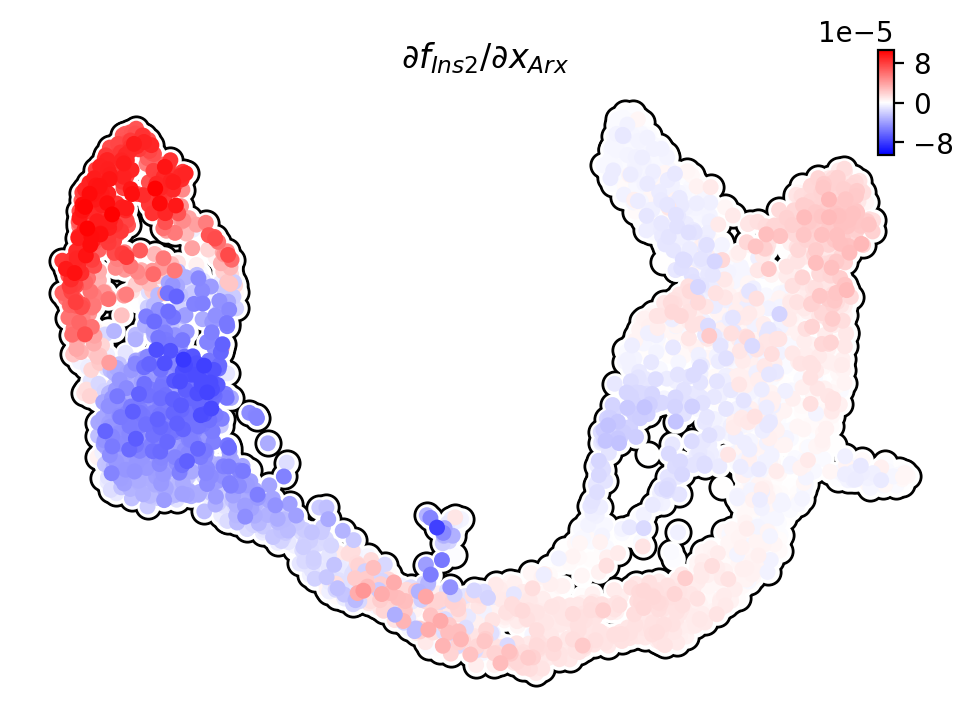

regulator: Ins2 effector: Arx arrow True


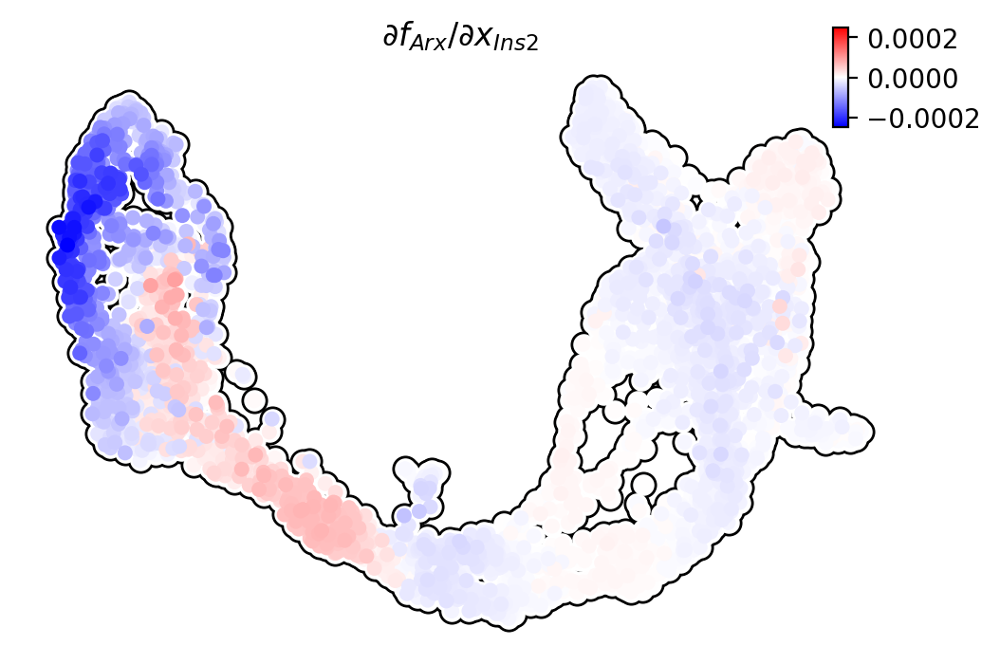

regulator: Pax6 effector: Arx arrow True


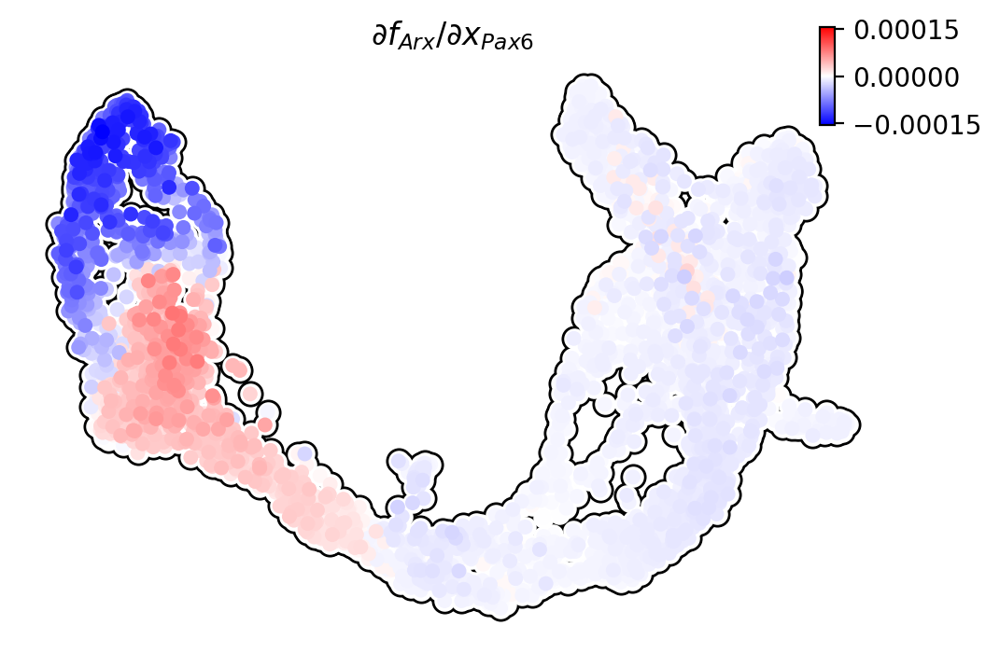

regulator: Arx effector: Pax6 arrow False


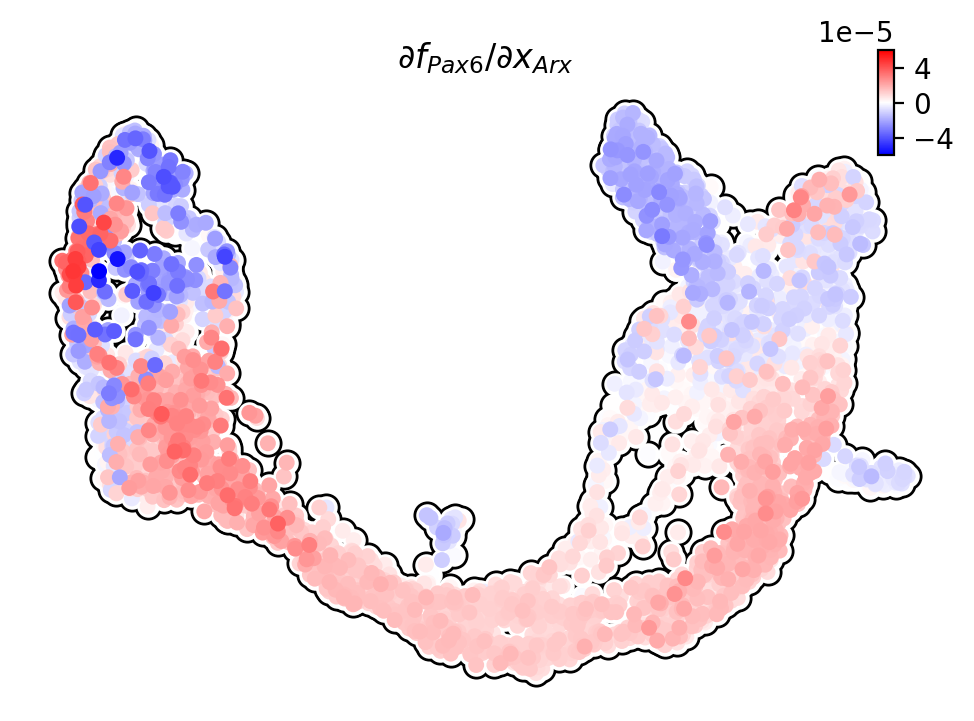

regulator: Gcg effector: Arx arrow True


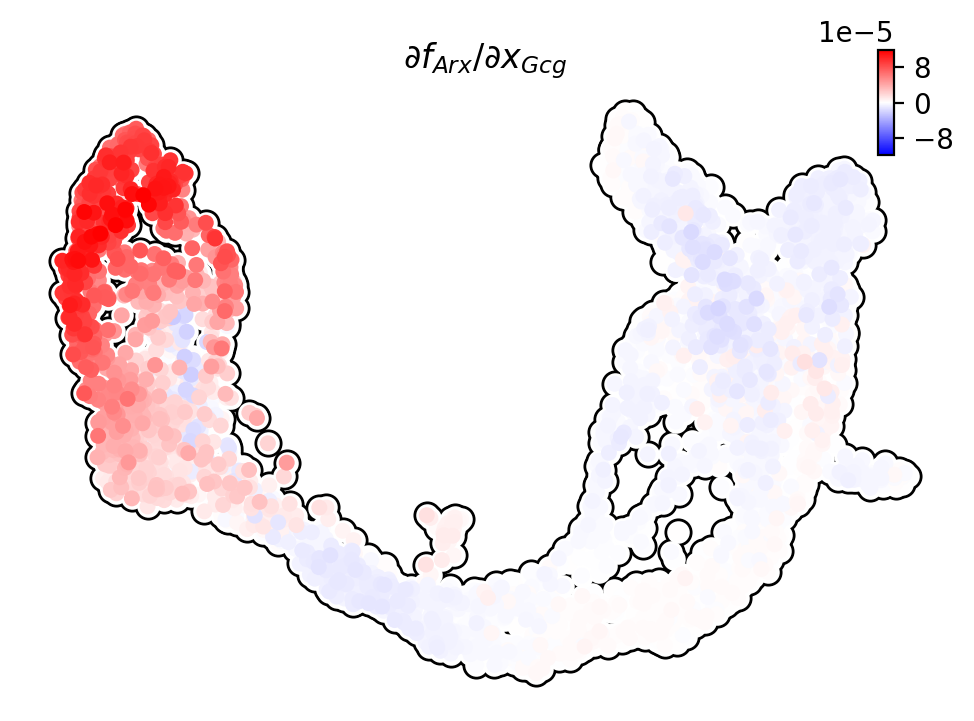

regulator: Arx effector: Gcg arrow False


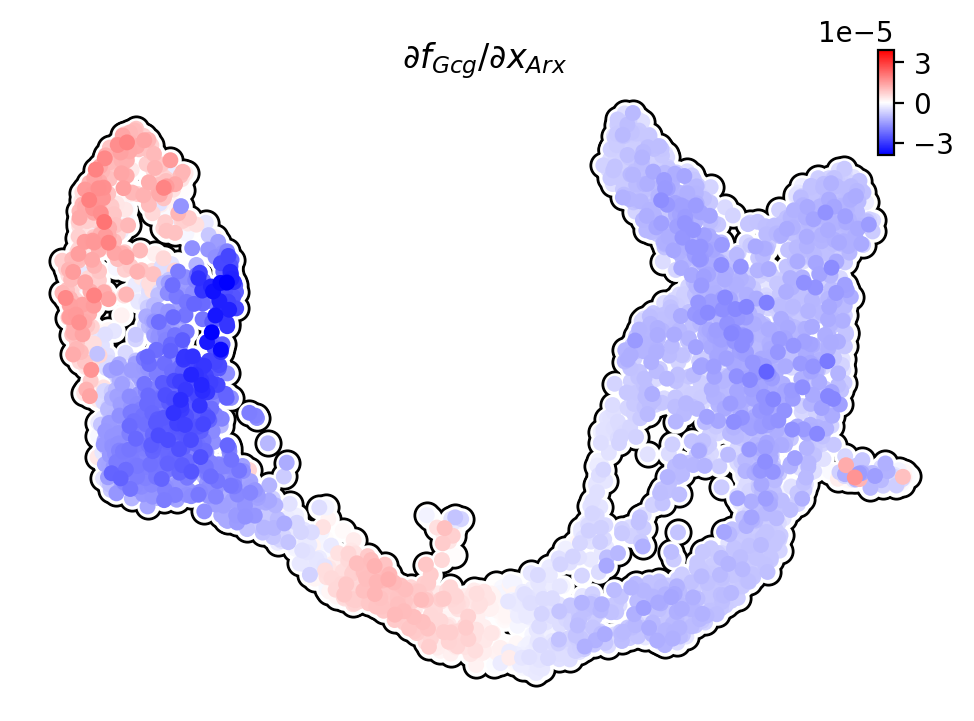

In [75]:
reg_list=[
    'Arx','Ins2', #ductal
    'Pax6','Arx', #ductal
    'Gcg','Arx', #ductal
         ]
          

eff_list=[
          'Ins2','Arx', #ductal
          'Arx','Pax6', #ductal
          'Arx','Gcg', #ductal

         ]

network_arrow_list=[True,True,
                    True,False,
                    True,False]

for reg,eff,network_arrow in zip(reg_list, eff_list,network_arrow_list):
    print('regulator:',reg,'effector:',eff,'arrow',network_arrow)
    dyn.pl.jacobian(
        adata,
        basis="umap",
        regulators=[
            reg,
        ],
        effectors=[eff],
        alpha=1,
    )

### beta

|-----> [iterating reg_groups] in progress: 100.0000%
|-----> [iterating reg_groups] finished [0.2370s]


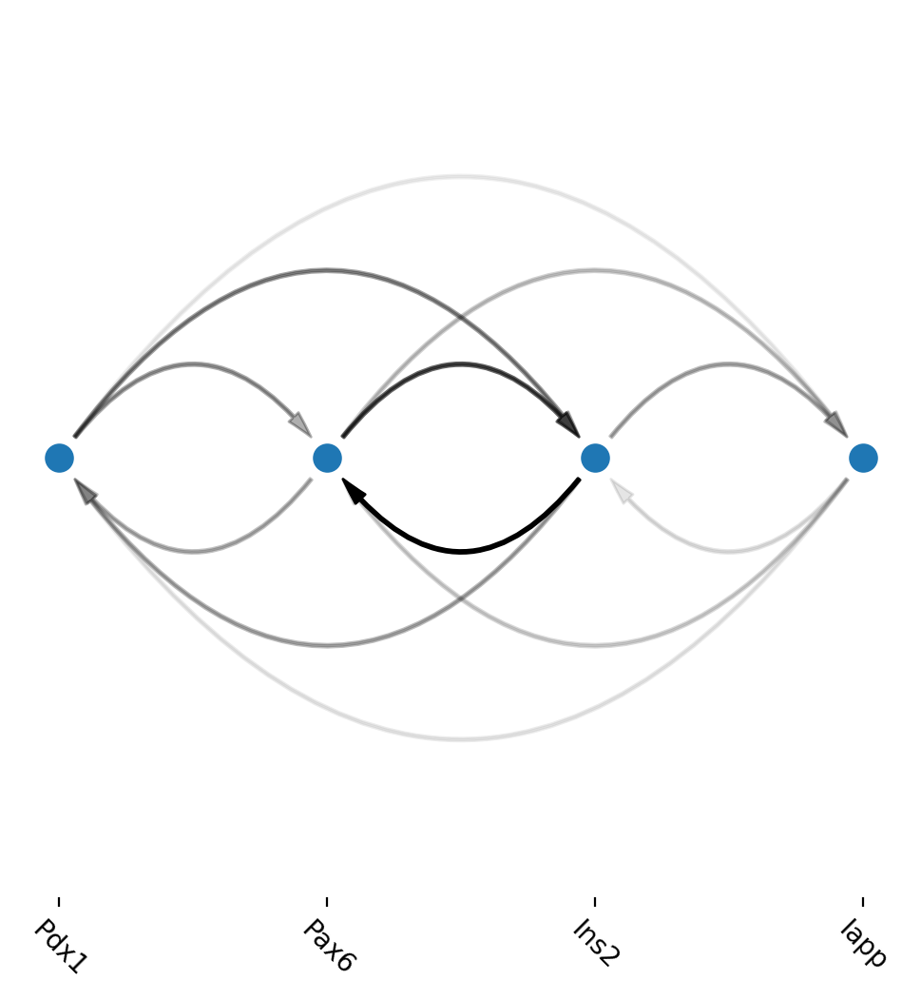

In [76]:
beta_cell_type_regulators = ["Pax6", "Pdx1", "Iapp", "Ins2"]

cell_type_regulators = beta_cell_type_regulators

cluster2edges = dyn.vf.build_network_per_cluster(
    adata,
    cluster="clusters",
    cluster_names=None,
    full_reg_rank=full_reg_rank,
    full_eff_rank=full_eff_rank,
    genes=cell_type_regulators,
    n_top_genes=100,
)

import networkx as nx
# ductal
network = nx.from_pandas_edgelist(
    cluster2edges["Beta"], "regulator", "target", edge_attr="weight", create_using=nx.DiGraph()
)
ax = dyn.pl.arcPlot(
    adata, cluster="clusters", cluster_name="Beta", edges_list=None, network=network, color=None
)  # color="M_s")


regulator: Pax6 effector: Ins2 arrow True


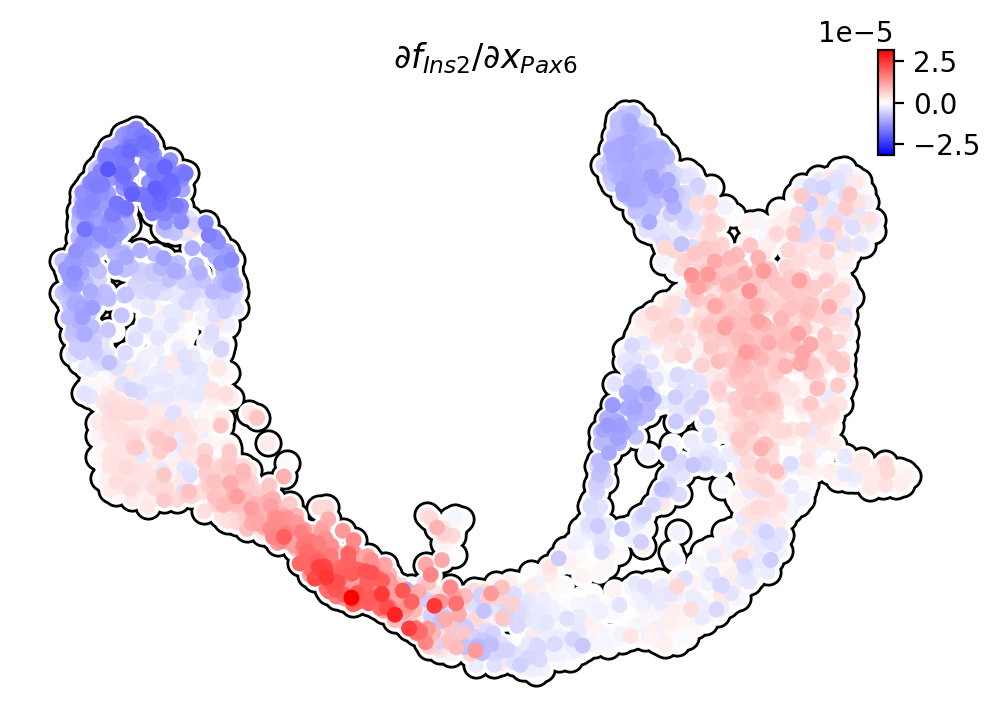

regulator: Ins2 effector: Arx arrow True


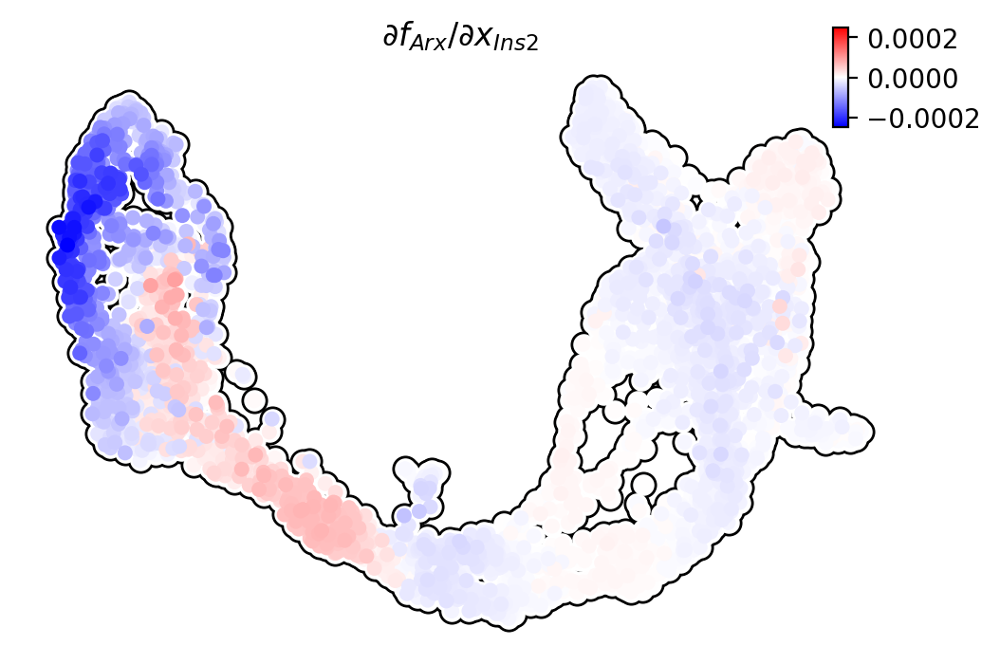

In [78]:
reg_list=[
    'Pax6','Ins2', #Beta
         ]
          

eff_list=[
          'Ins2','Arx', #Beta

         ]

network_arrow_list=[True,True]

for reg,eff,network_arrow in zip(reg_list, eff_list,network_arrow_list):
    print('regulator:',reg,'effector:',eff,'arrow',network_arrow)
    dyn.pl.jacobian(
        adata,
        basis="umap",
        regulators=[
            reg,
        ],
        effectors=[eff],
        alpha=1,
    )

### alpha

|-----> [iterating reg_groups] in progress: 100.0000%
|-----> [iterating reg_groups] finished [0.3120s]


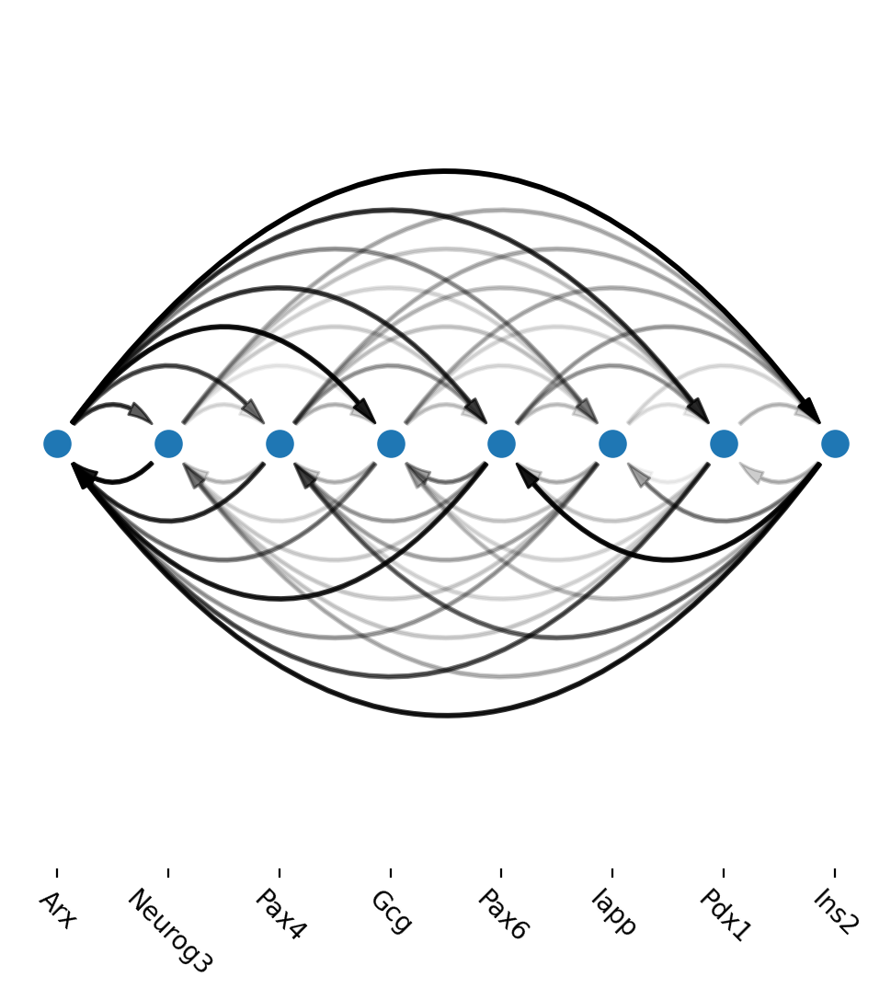

In [79]:
alpha_cell_type_regulators = ["Pax6", "Pdx1", "Iapp", "Ins2", "Neurog3", "Arx", "Pax4", "Gcg", "Ss5", "Ghri"]

cell_type_regulators = alpha_cell_type_regulators

cluster2edges = dyn.vf.build_network_per_cluster(
    adata,
    cluster="clusters",
    cluster_names=None,
    full_reg_rank=full_reg_rank,
    full_eff_rank=full_eff_rank,
    genes=cell_type_regulators,
    n_top_genes=100,
)

import networkx as nx
# ductal
network = nx.from_pandas_edgelist(
    cluster2edges["Alpha"], "regulator", "target", edge_attr="weight", create_using=nx.DiGraph()
)
ax = dyn.pl.arcPlot(
    adata, cluster="clusters", cluster_name="Beta", edges_list=None, network=network, color=None
)  # color="M_s")


regulator: Pax6 effector: Ins2 arrow True


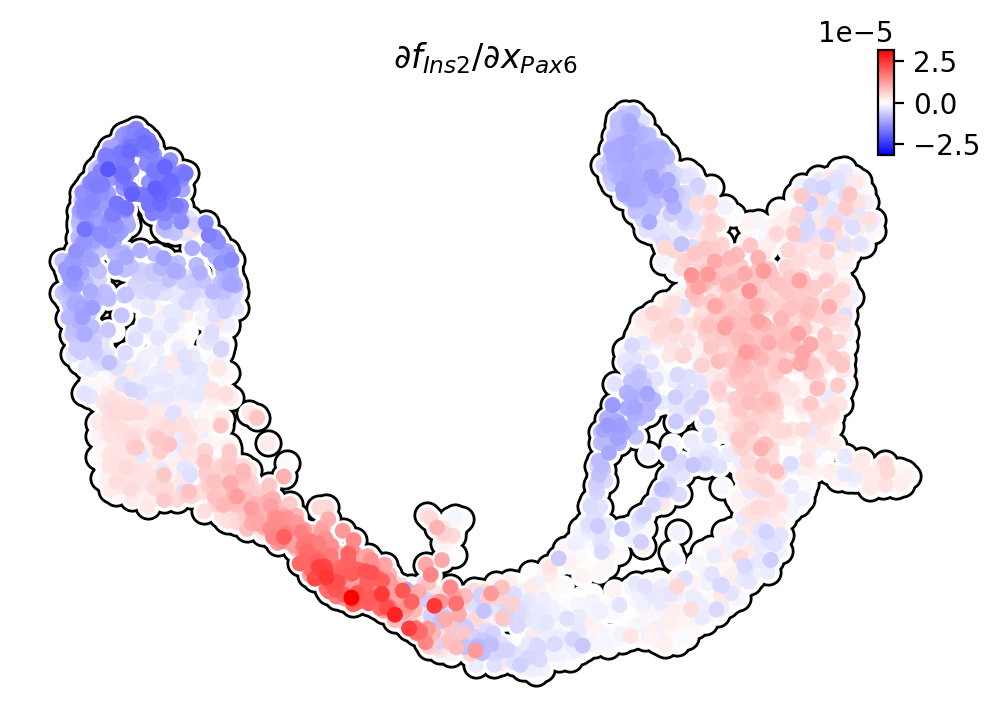

regulator: Ins2 effector: Pax6 arrow True


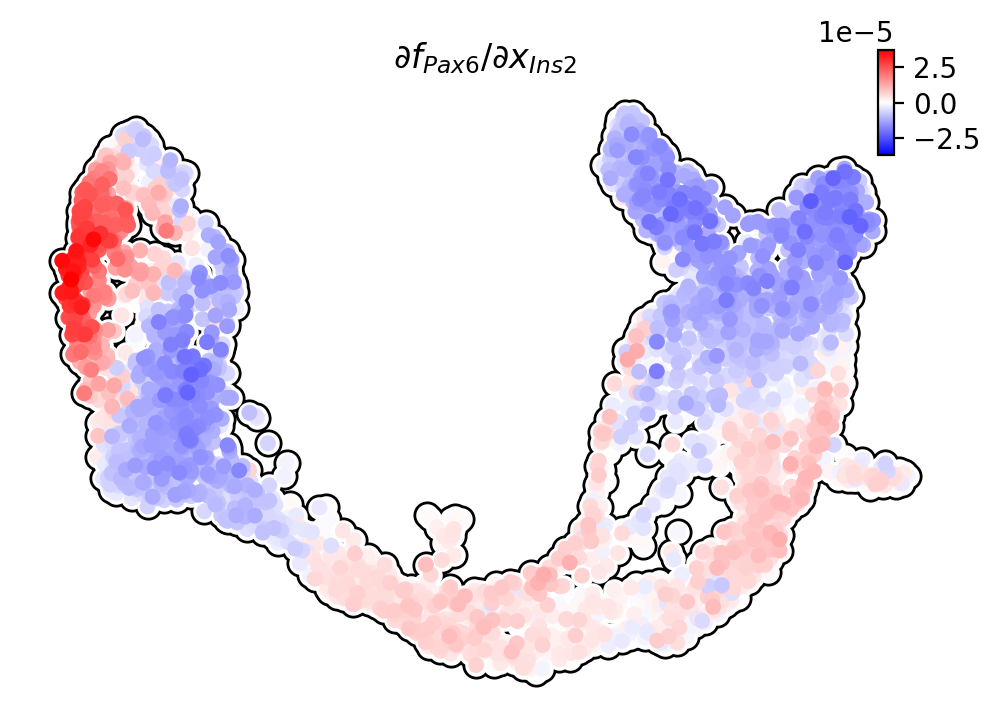

In [83]:
reg_list=[
    # 'Arx','Ins2', #Beta
    # 'Arx','Neurog3'
        'Pax6','Ins2', #Beta

         ]
          

eff_list=[
          # 'Arx','Ins2', #Beta
          # 'Neurog3','Arx'
    'Ins2','Pax6', #Beta

         ]

network_arrow_list=[True,True,True,True]

for reg,eff,network_arrow in zip(reg_list, eff_list,network_arrow_list):
    print('regulator:',reg,'effector:',eff,'arrow',network_arrow)
    dyn.pl.jacobian(
        adata,
        basis="umap",
        regulators=[
            reg,
        ],
        effectors=[eff],
        alpha=1,
    )

In [114]:
# pancreas_genes=['Hes1',
#  'Nkx6-1',
#  'Nkx2-2',
#  'Neurog3',
#  'Neurod1',
#  'Pax4',
#  'Pax6',
#  'Arx',
#  'Pdx1',
#  'Ins1',
#  'Ins2',
#  'Ghrl',
#  # 'Ptf1a',
#  'Iapp',
#  'Isl1',
#  'Sox9',
#  'Gcg']

pancreas_genes=[
                'Arx',
    'Pax6',
    'Pax4',
    'Sox9',
    "Hes1",
    'Neurog3',
                'Pdx1']

|-----> [iterating reg_groups] in progress: 100.0000%
|-----> [iterating reg_groups] finished [0.2959s]
regulator: Arx effector: Arx


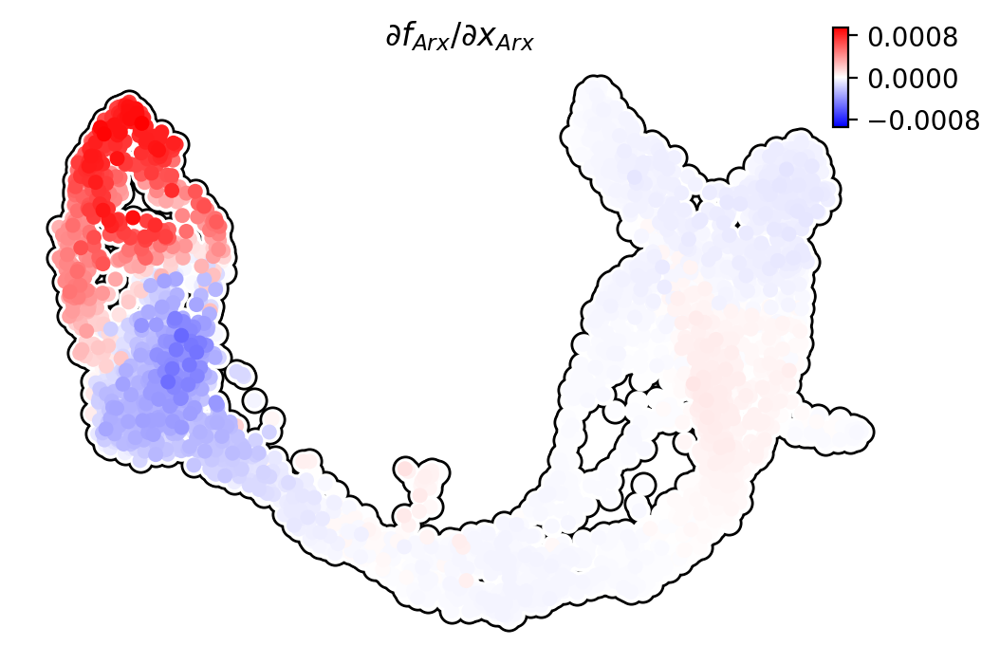

regulator: Arx effector: Pax6


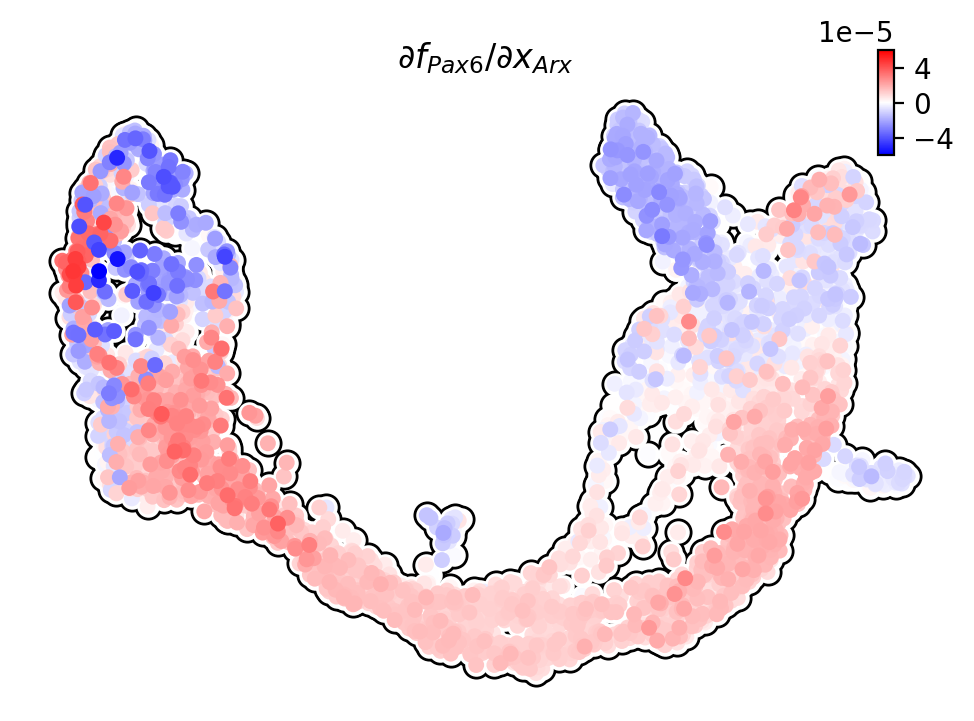

regulator: Arx effector: Pax4


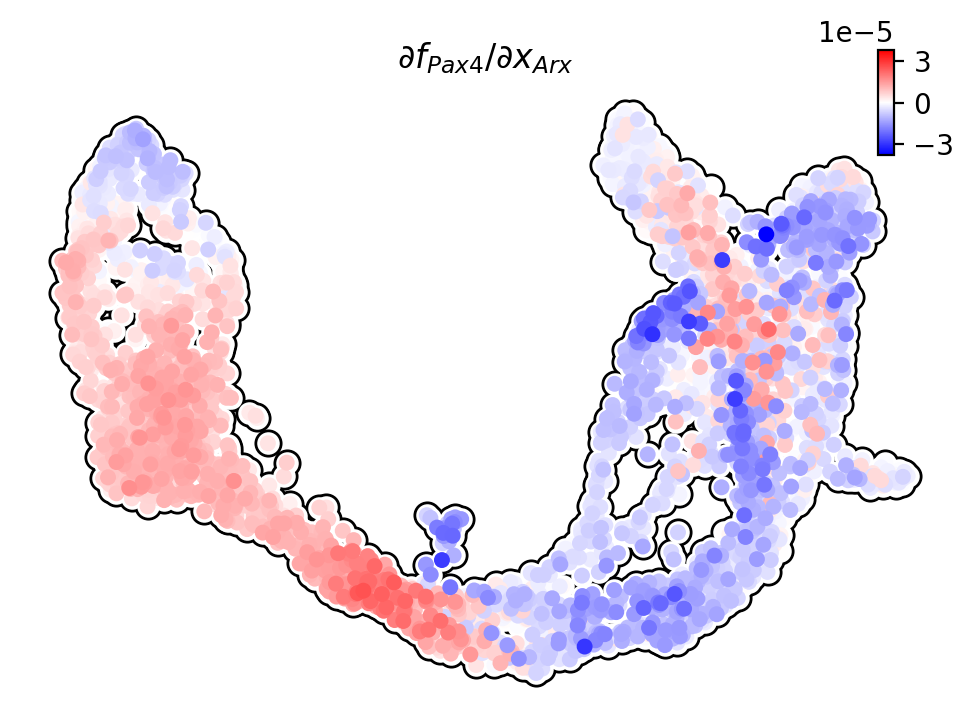

regulator: Arx effector: Sox9


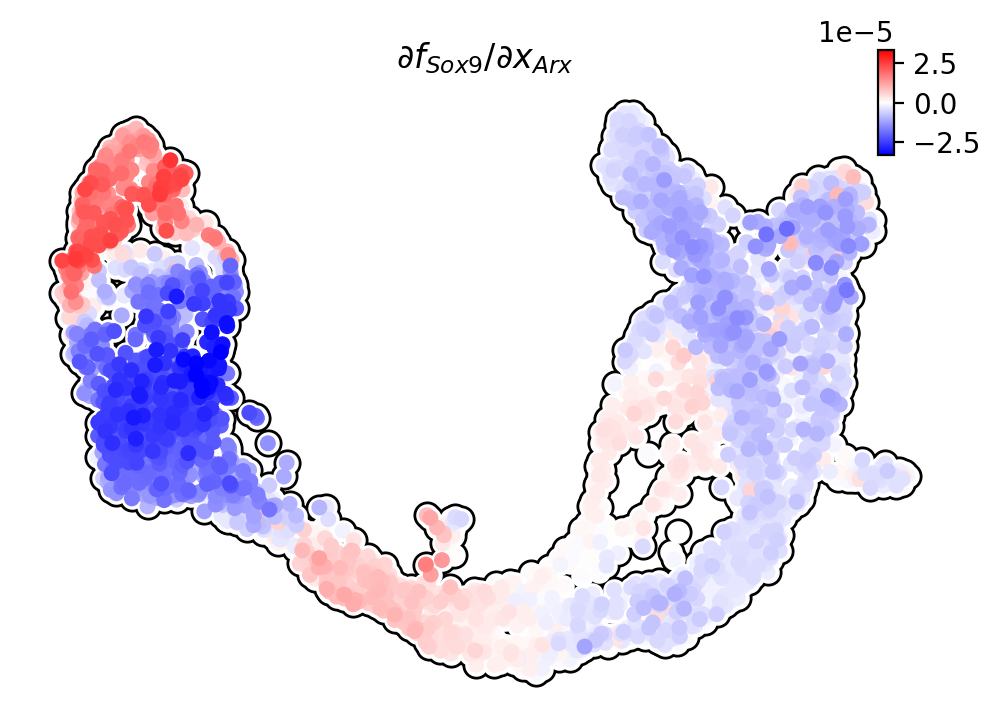

regulator: Arx effector: Hes1


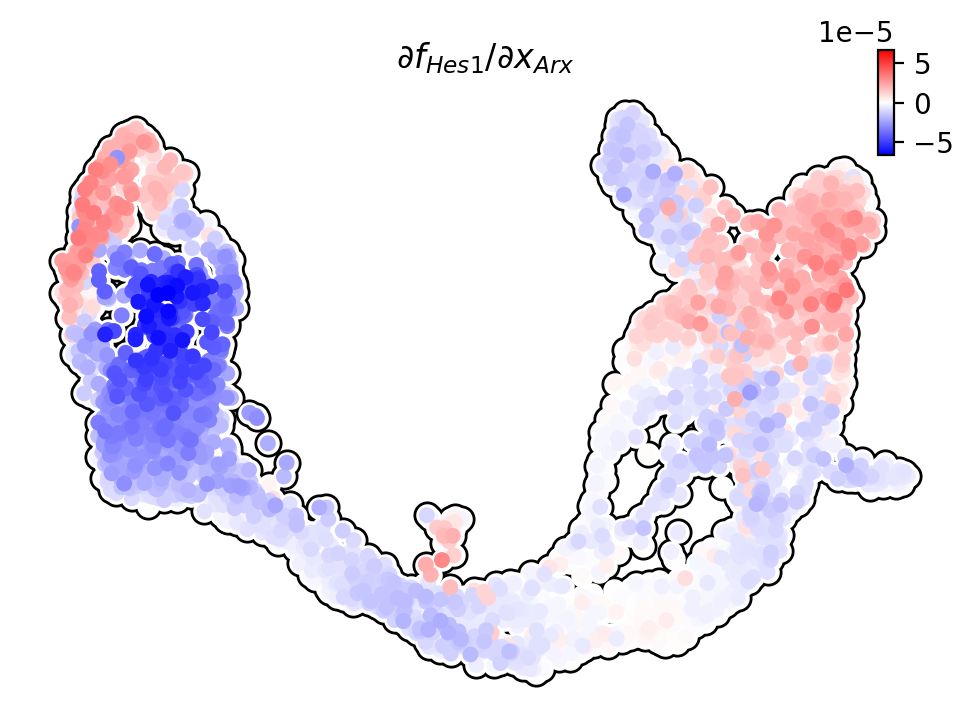

regulator: Arx effector: Neurog3


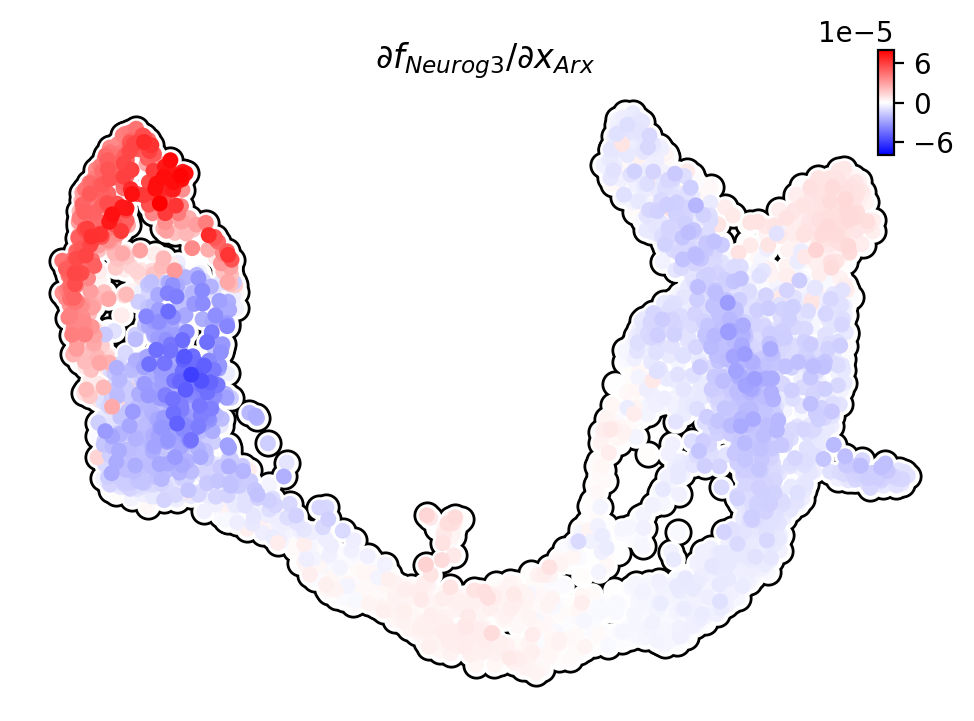

regulator: Arx effector: Pdx1


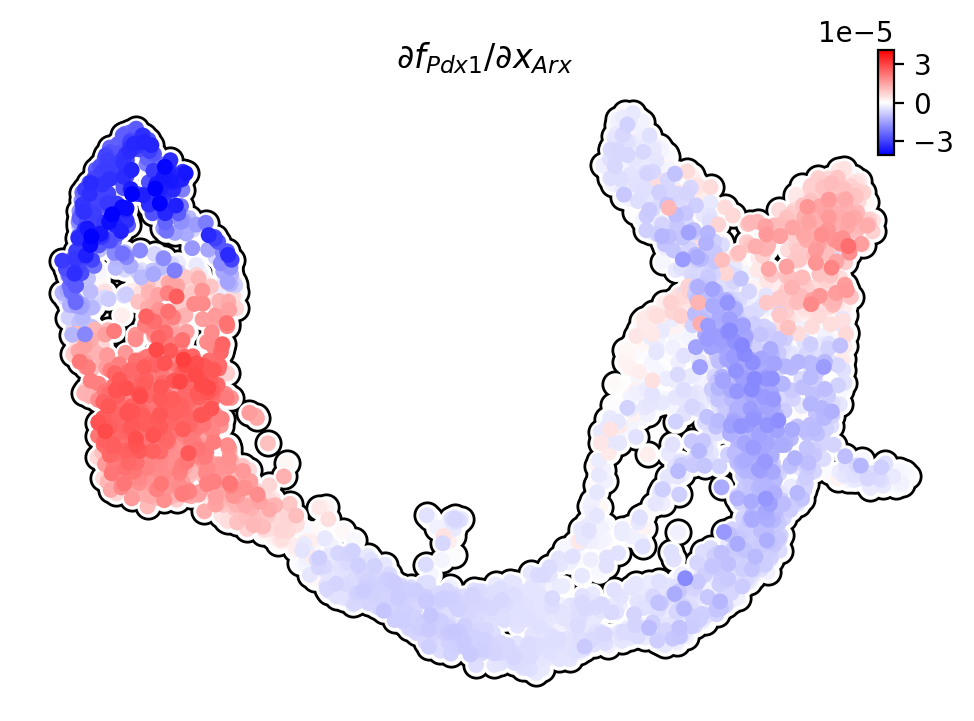

regulator: Pax6 effector: Arx


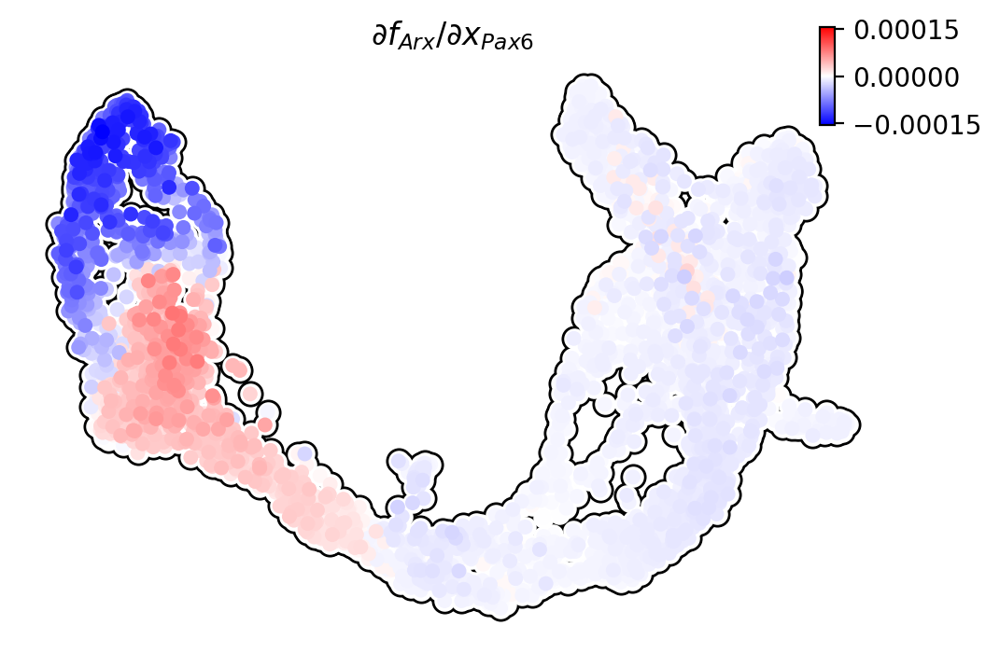

regulator: Pax6 effector: Pax6


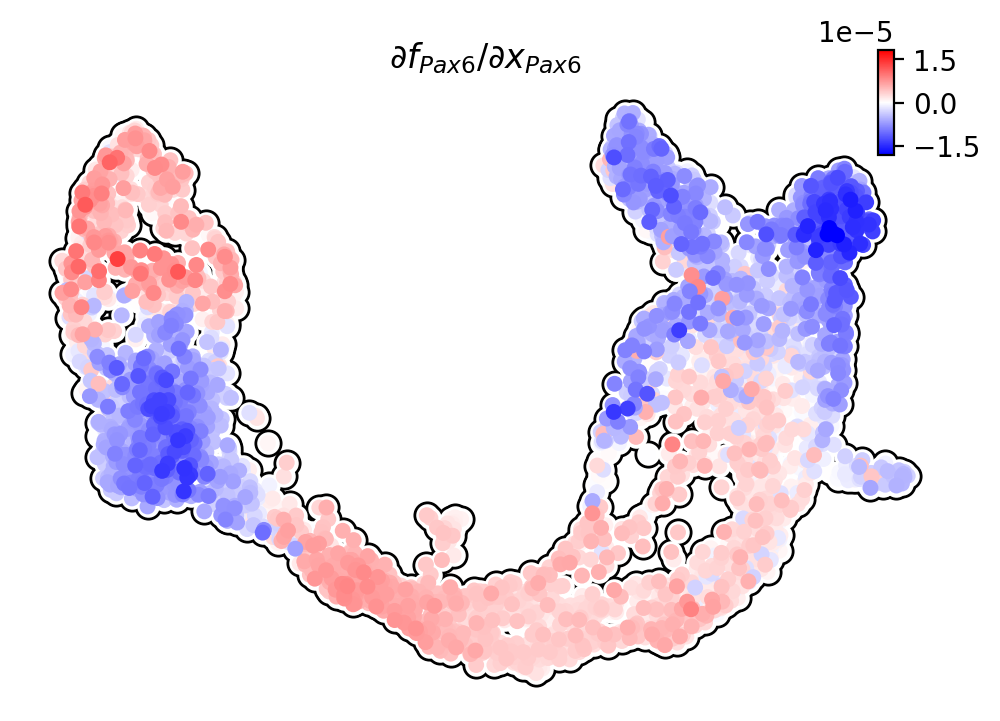

regulator: Pax6 effector: Pax4


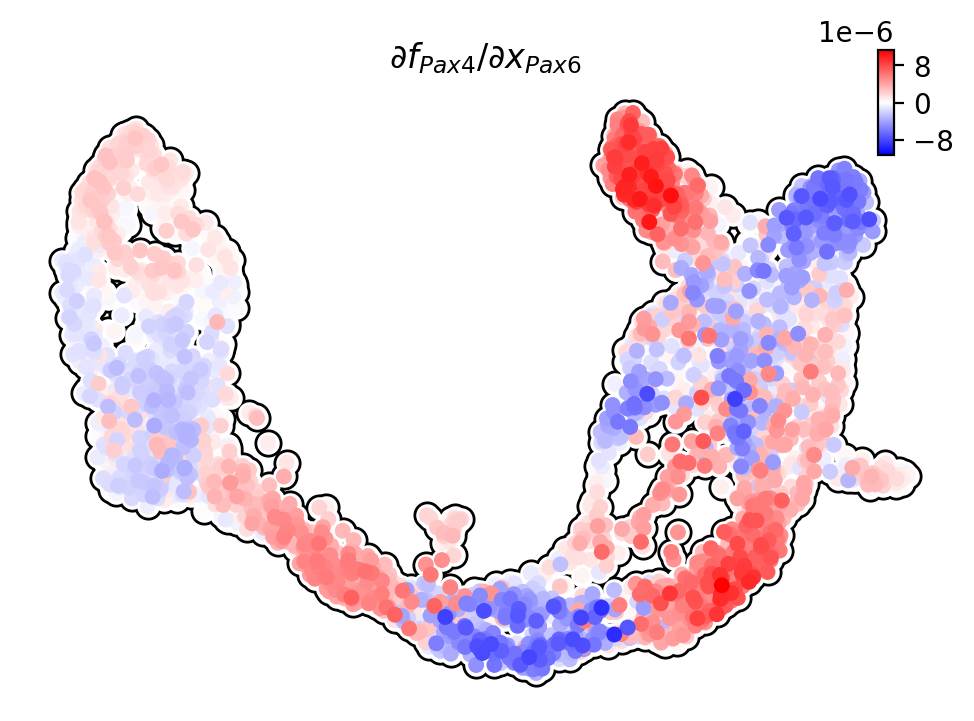

regulator: Pax6 effector: Sox9


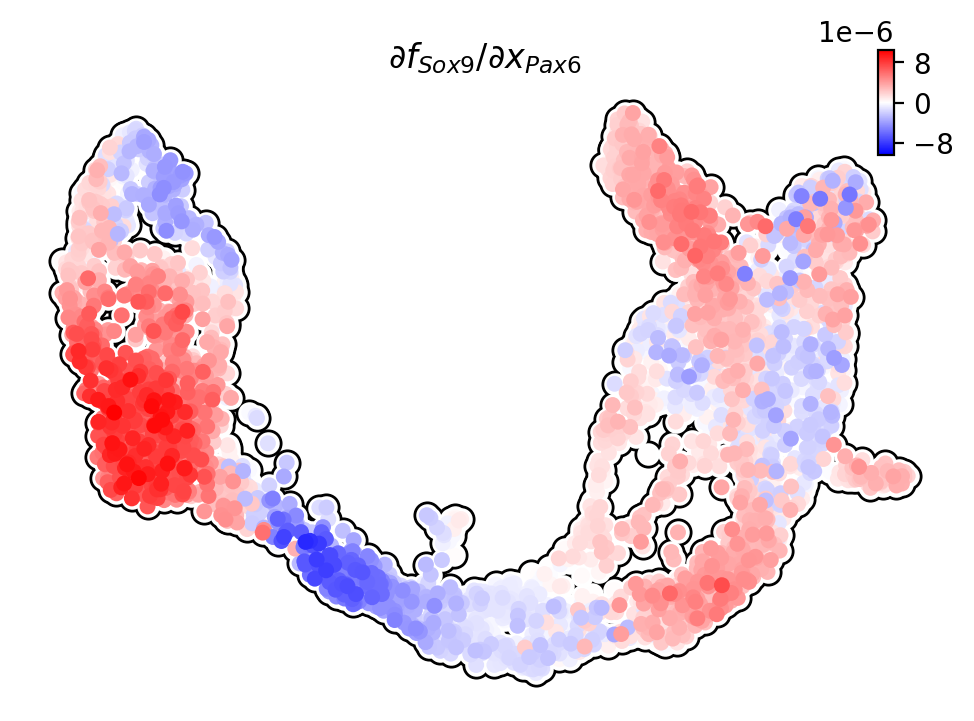

regulator: Pax6 effector: Hes1


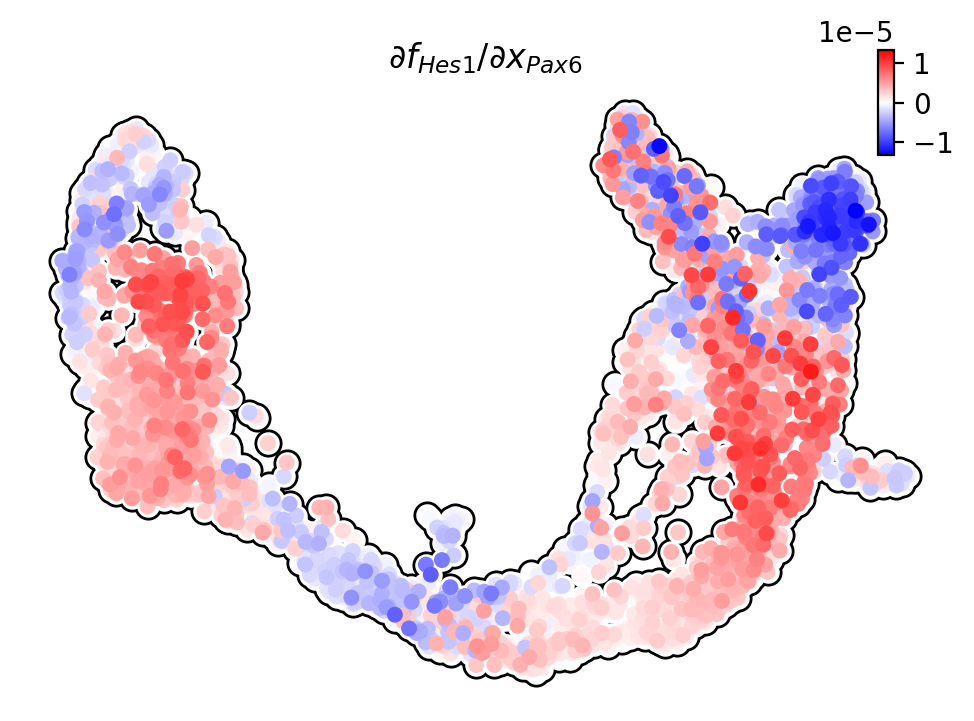

regulator: Pax6 effector: Neurog3


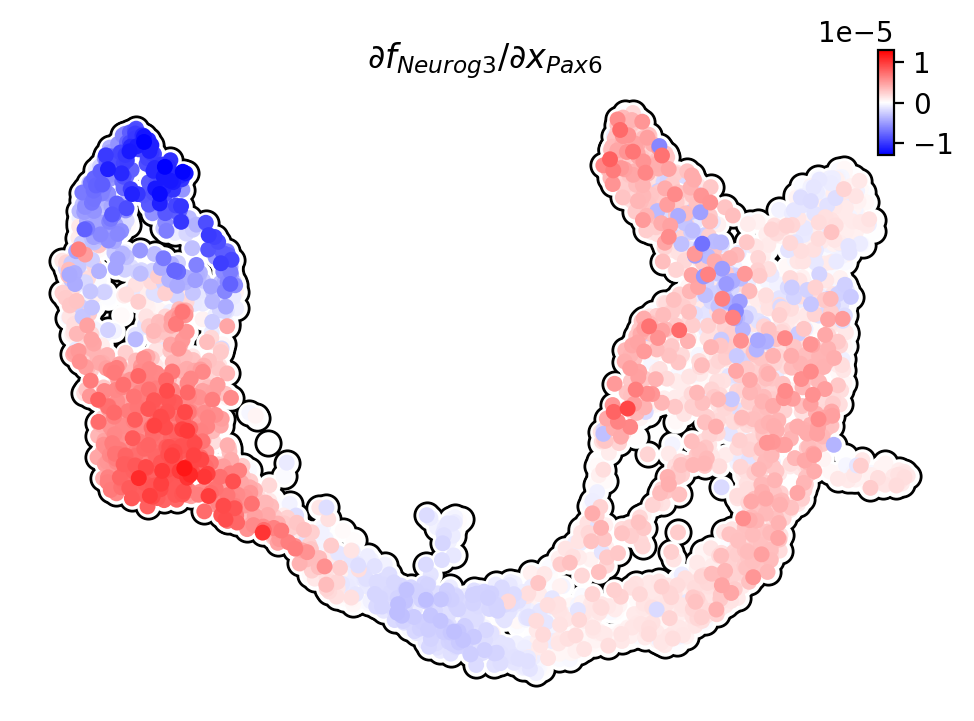

regulator: Pax6 effector: Pdx1


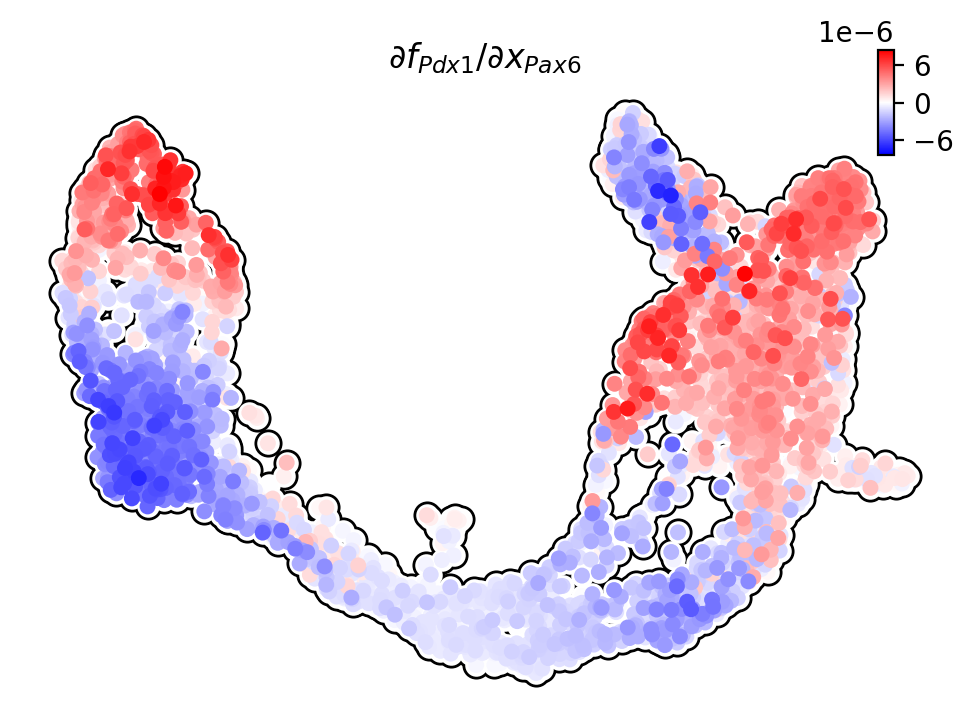

regulator: Pax4 effector: Arx


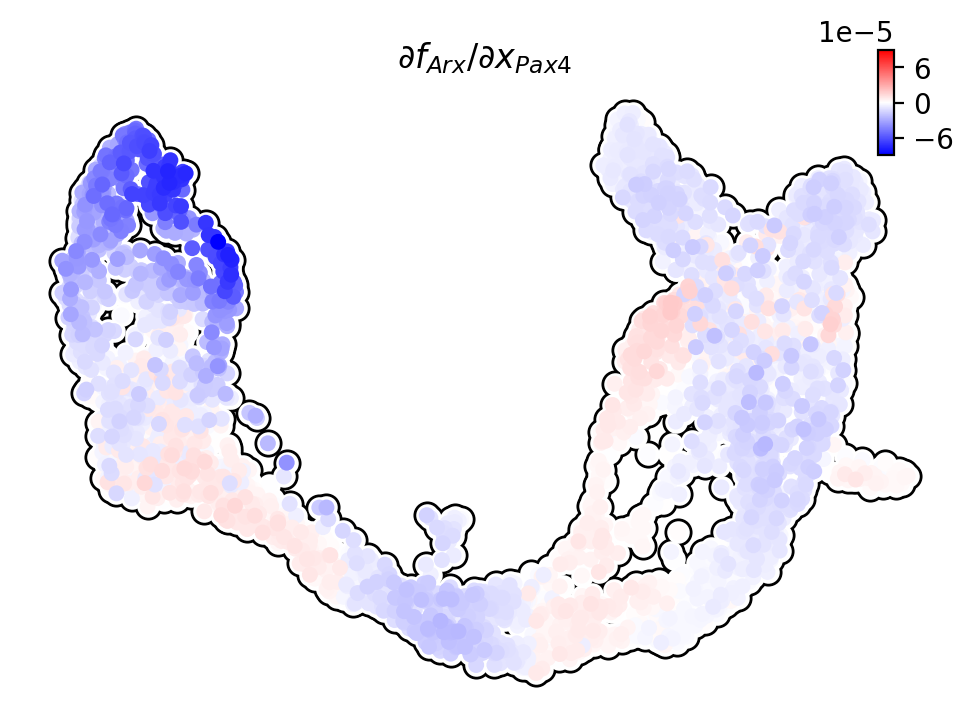

regulator: Pax4 effector: Pax6


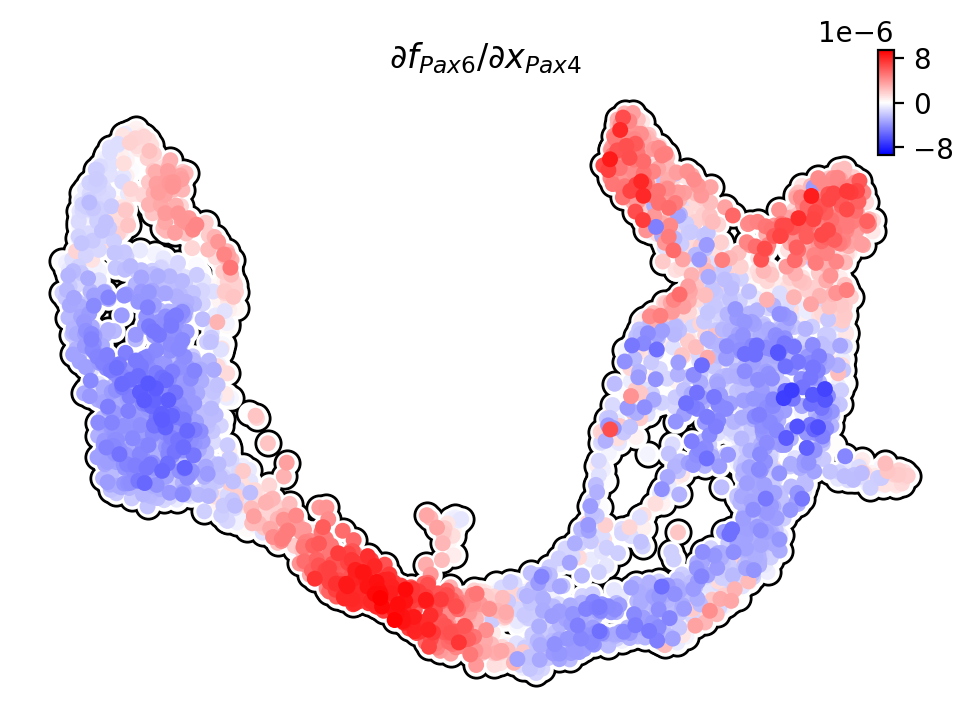

regulator: Pax4 effector: Pax4


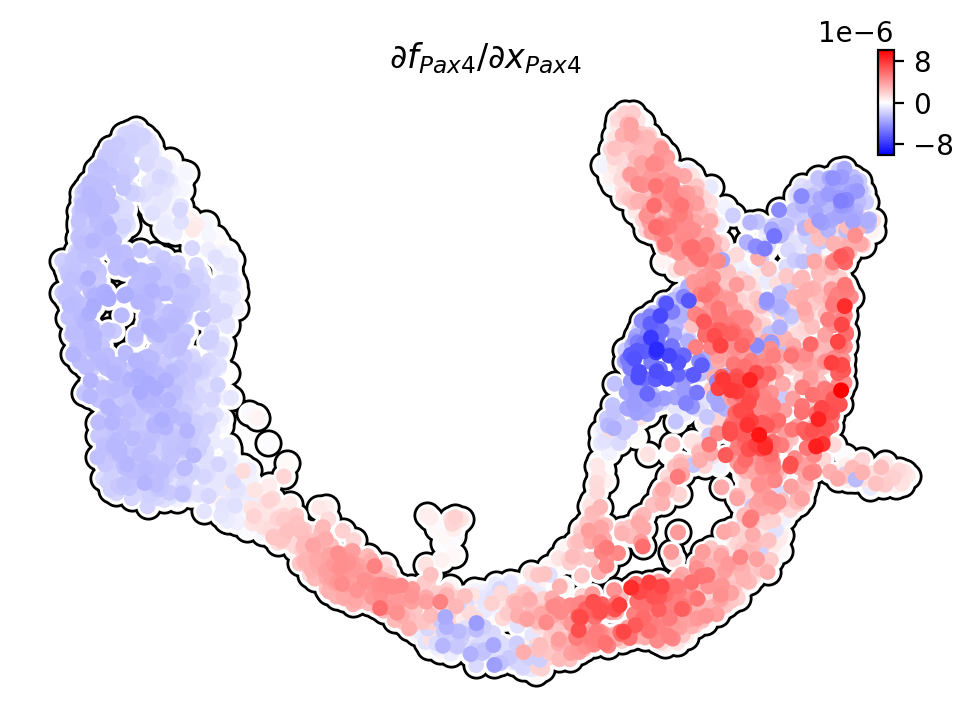

regulator: Pax4 effector: Sox9


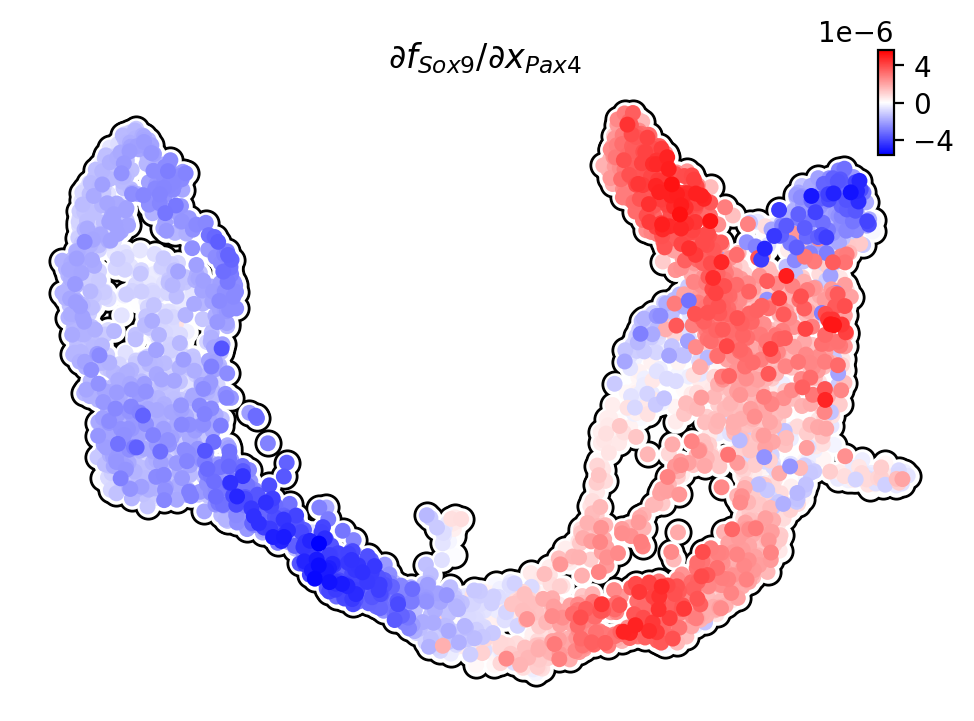

regulator: Pax4 effector: Hes1


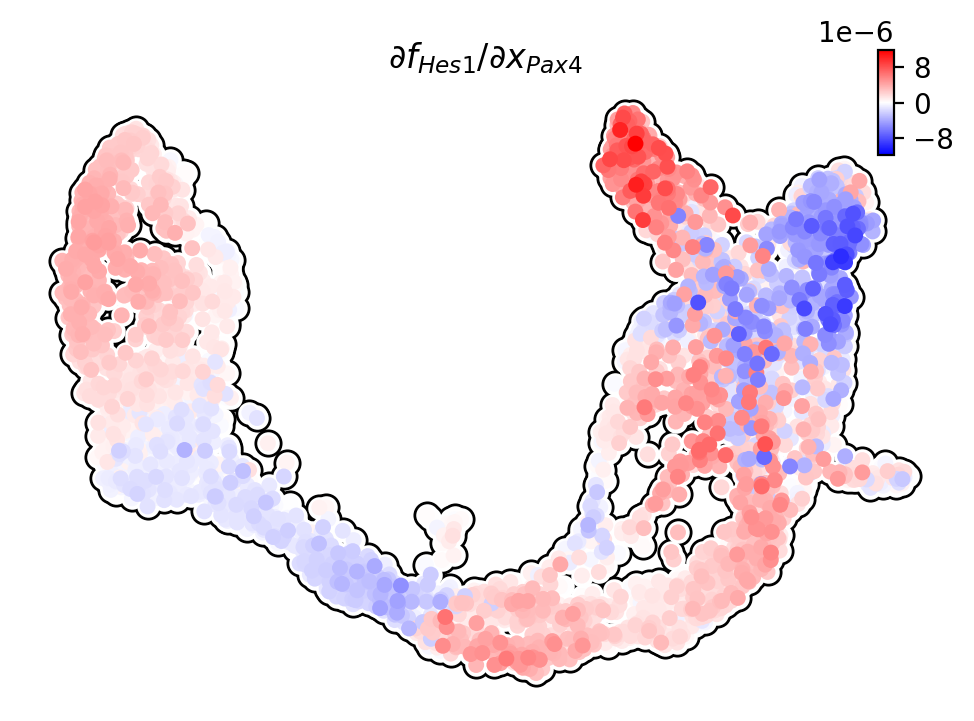

regulator: Pax4 effector: Neurog3


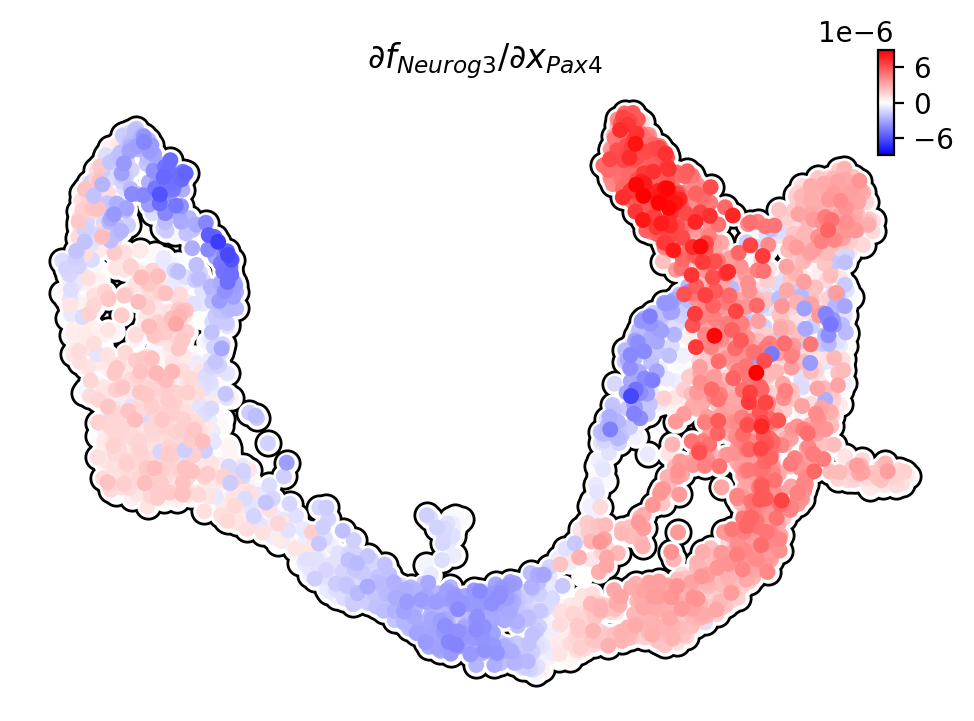

regulator: Pax4 effector: Pdx1


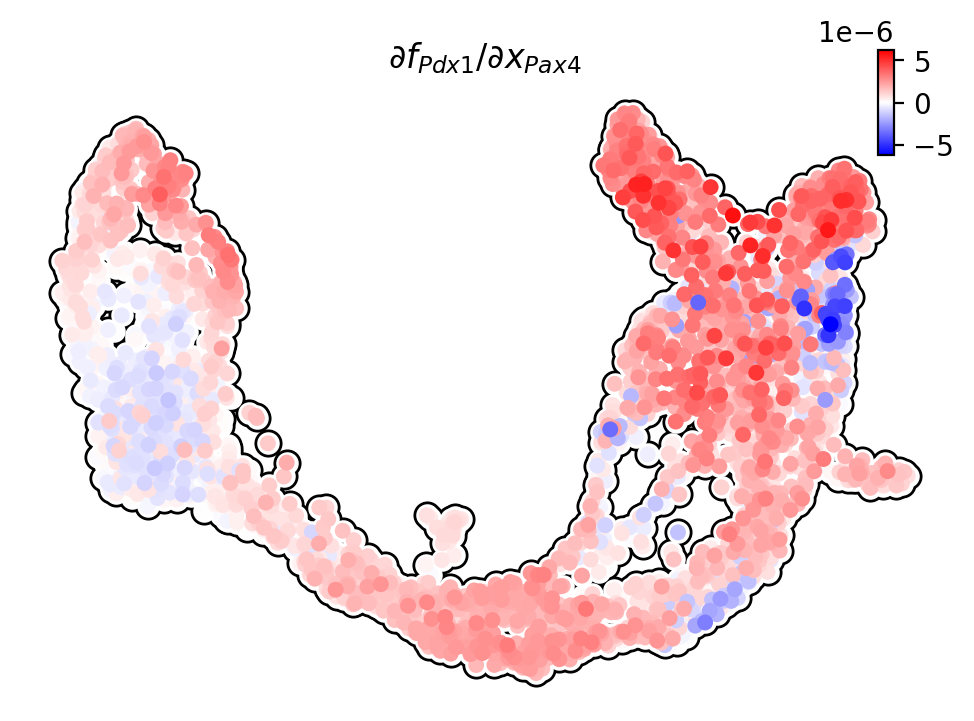

regulator: Sox9 effector: Arx


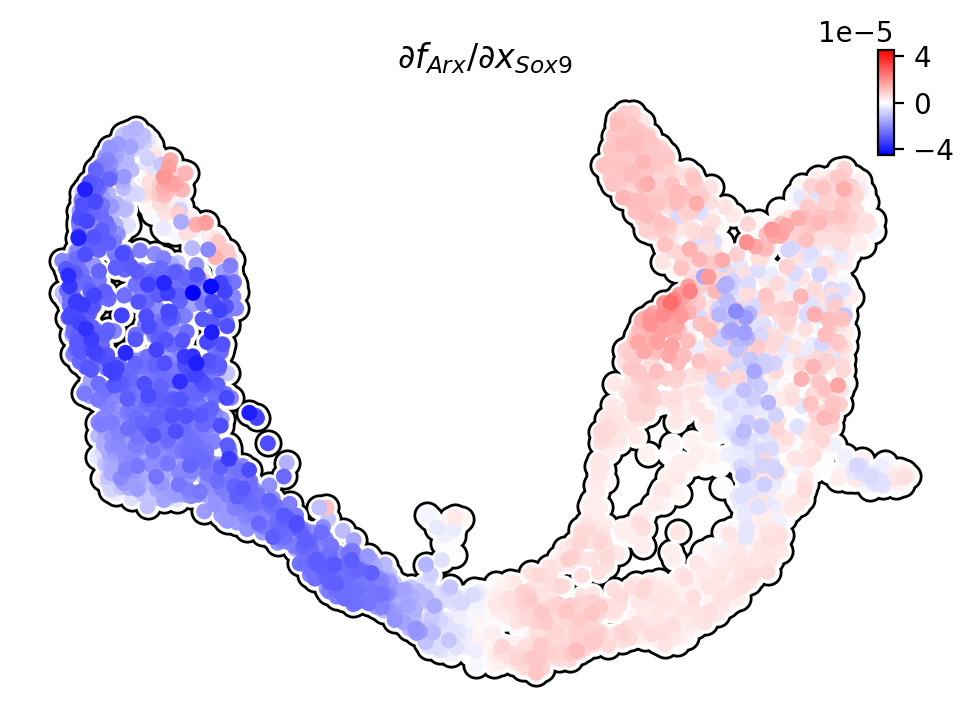

regulator: Sox9 effector: Pax6


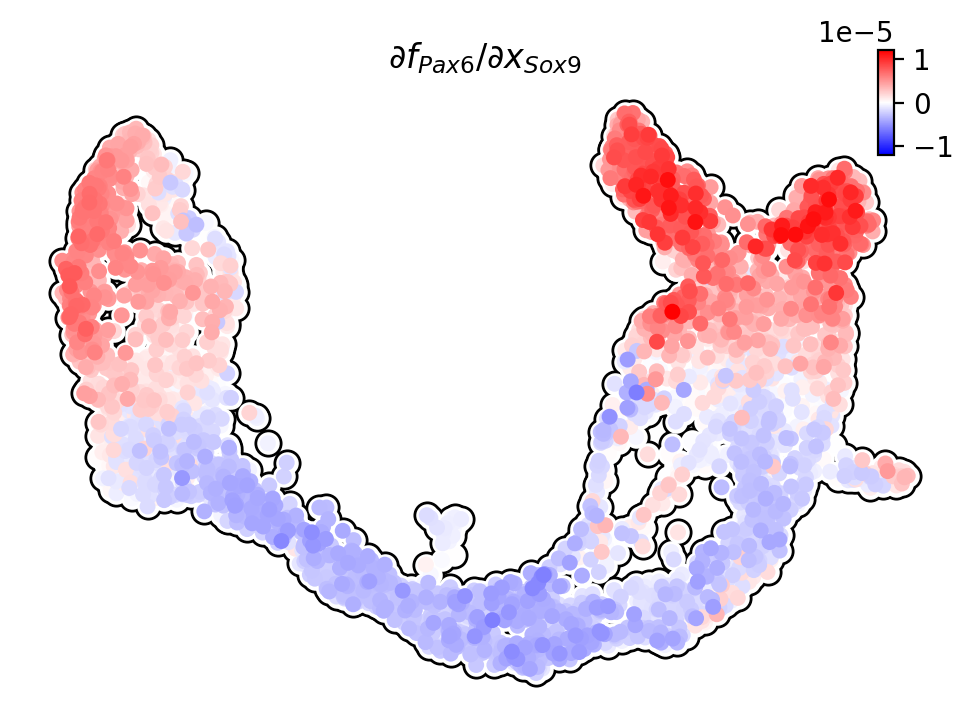

regulator: Sox9 effector: Pax4


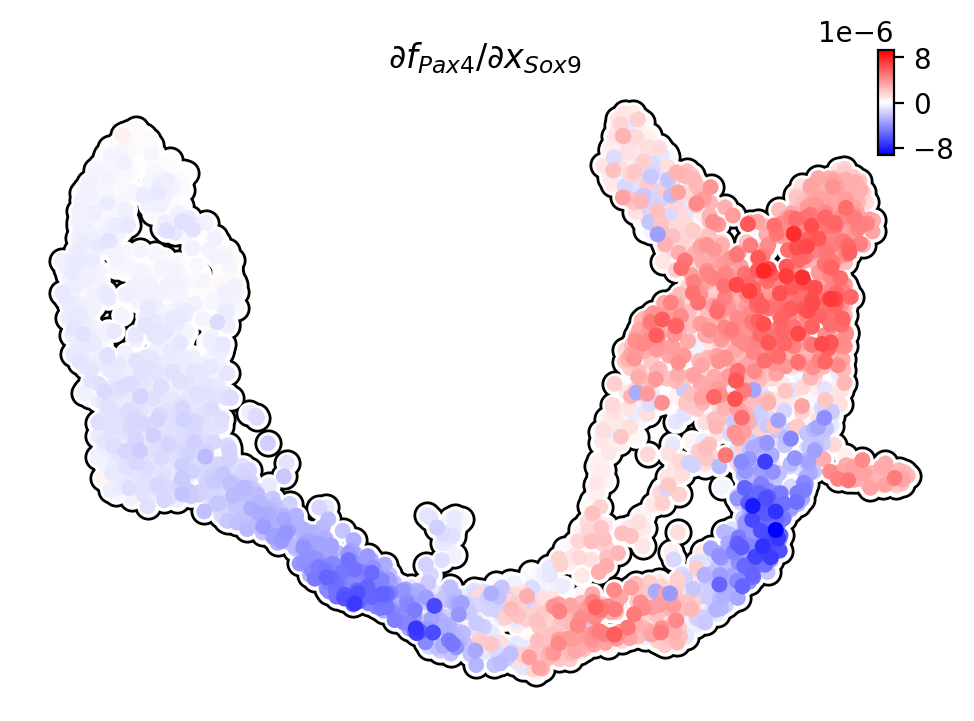

regulator: Sox9 effector: Sox9


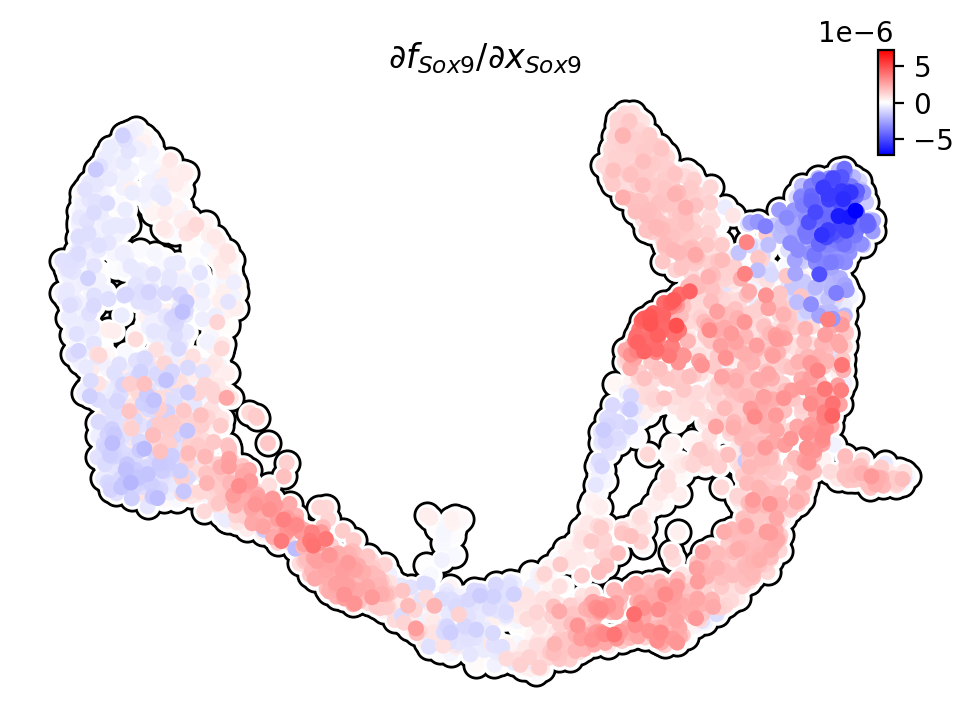

regulator: Sox9 effector: Hes1


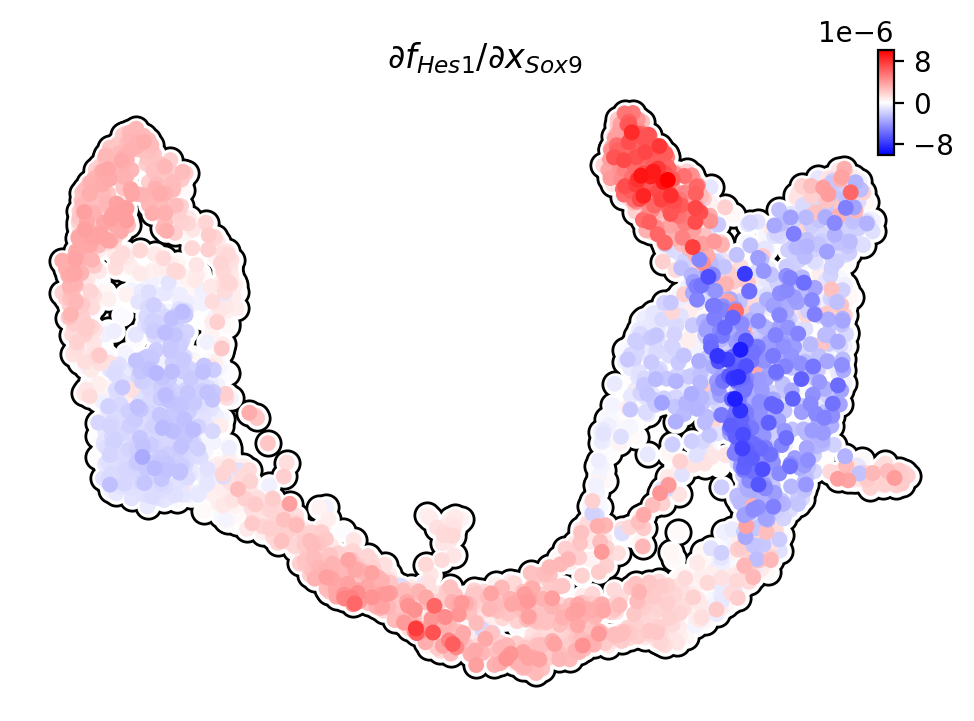

regulator: Sox9 effector: Neurog3


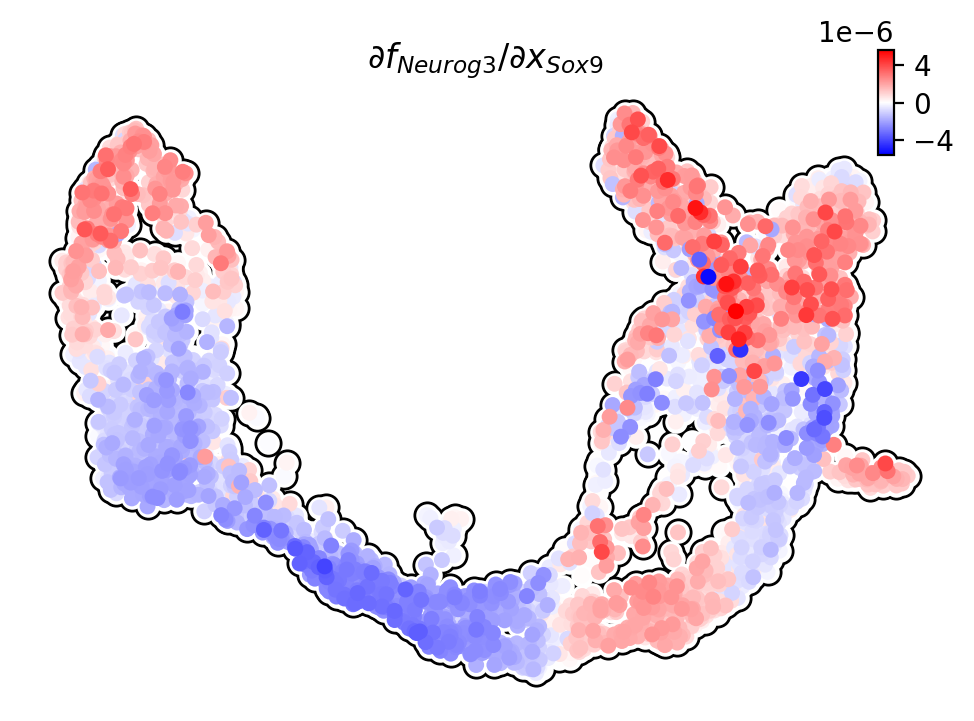

regulator: Sox9 effector: Pdx1


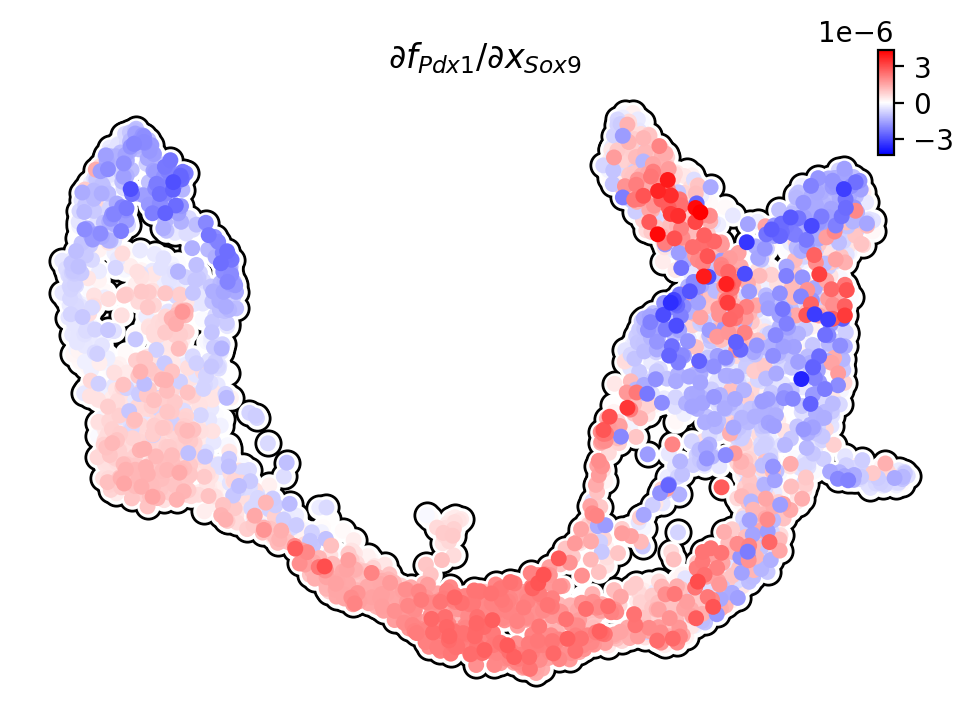

regulator: Hes1 effector: Arx


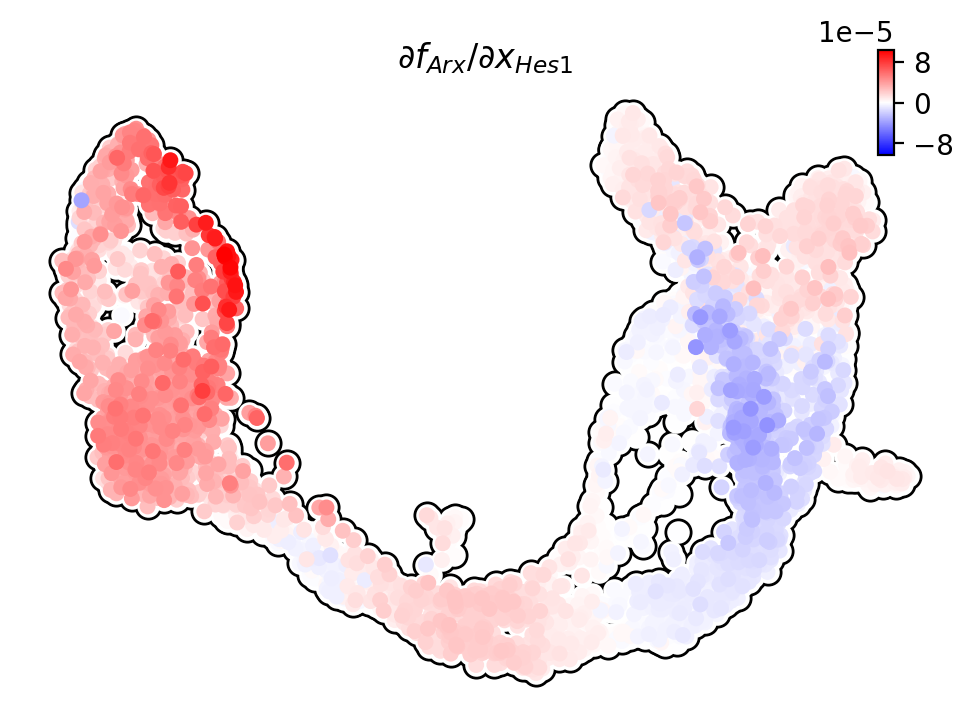

regulator: Hes1 effector: Pax6


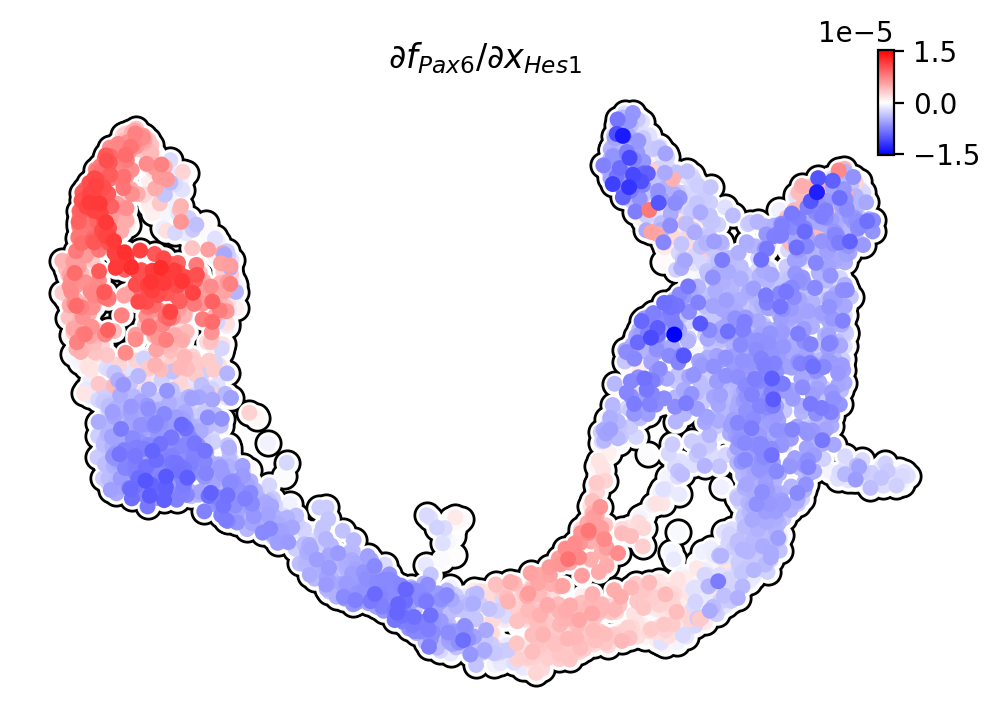

regulator: Hes1 effector: Pax4


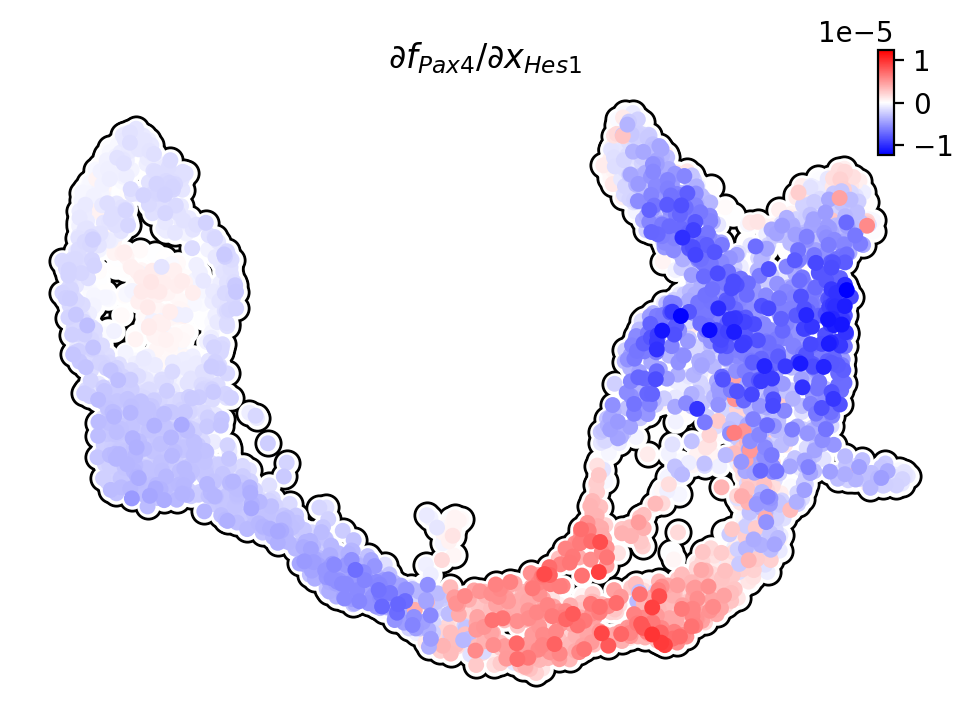

regulator: Hes1 effector: Sox9


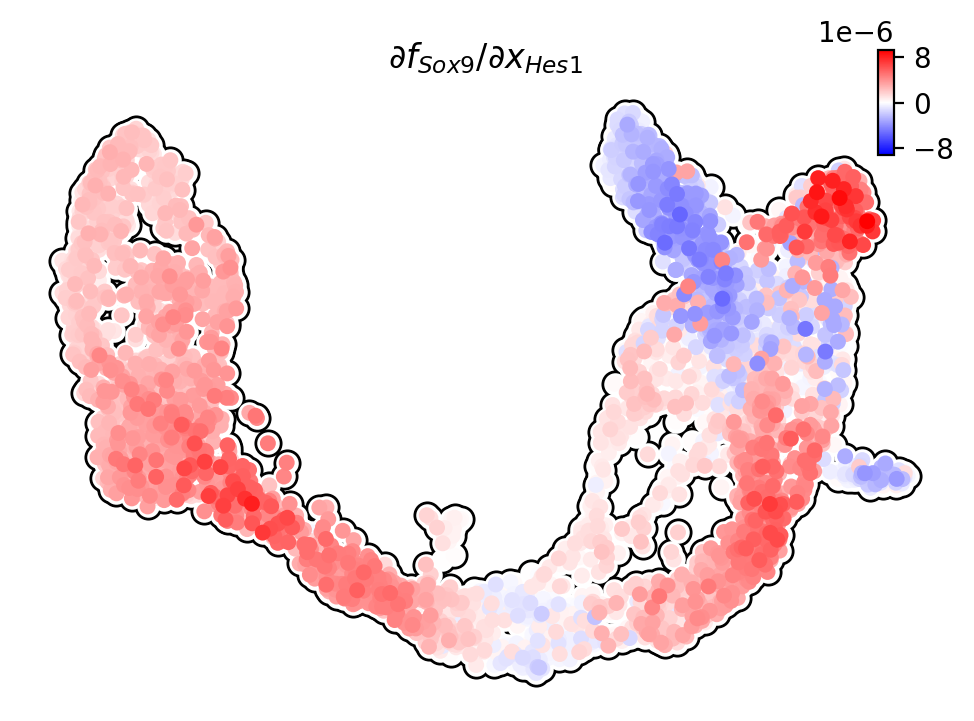

regulator: Hes1 effector: Hes1


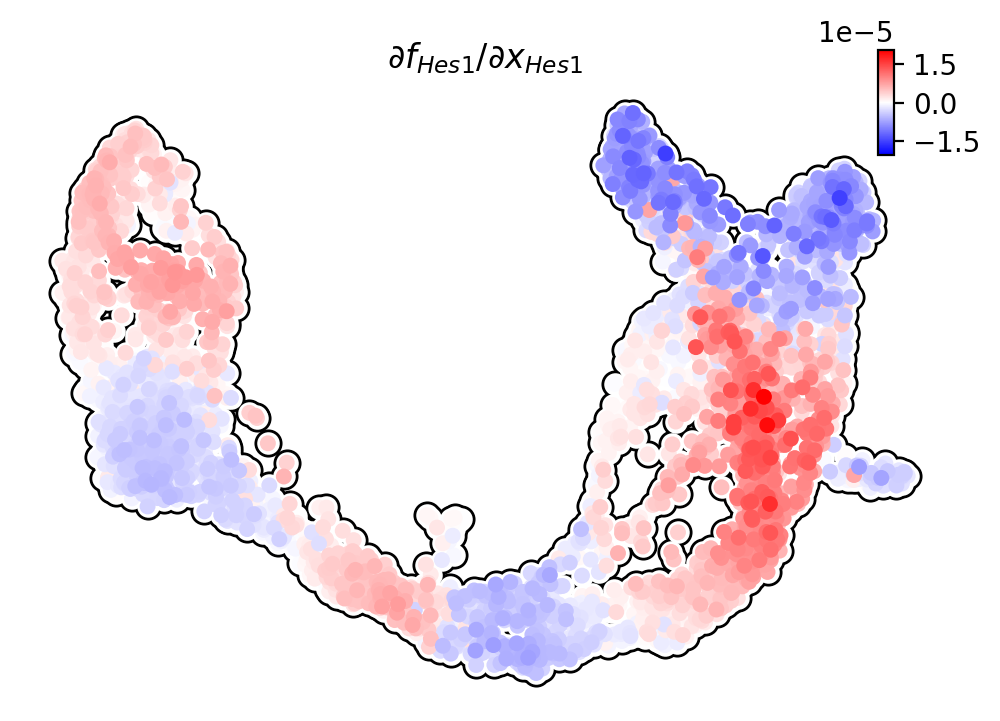

regulator: Hes1 effector: Neurog3


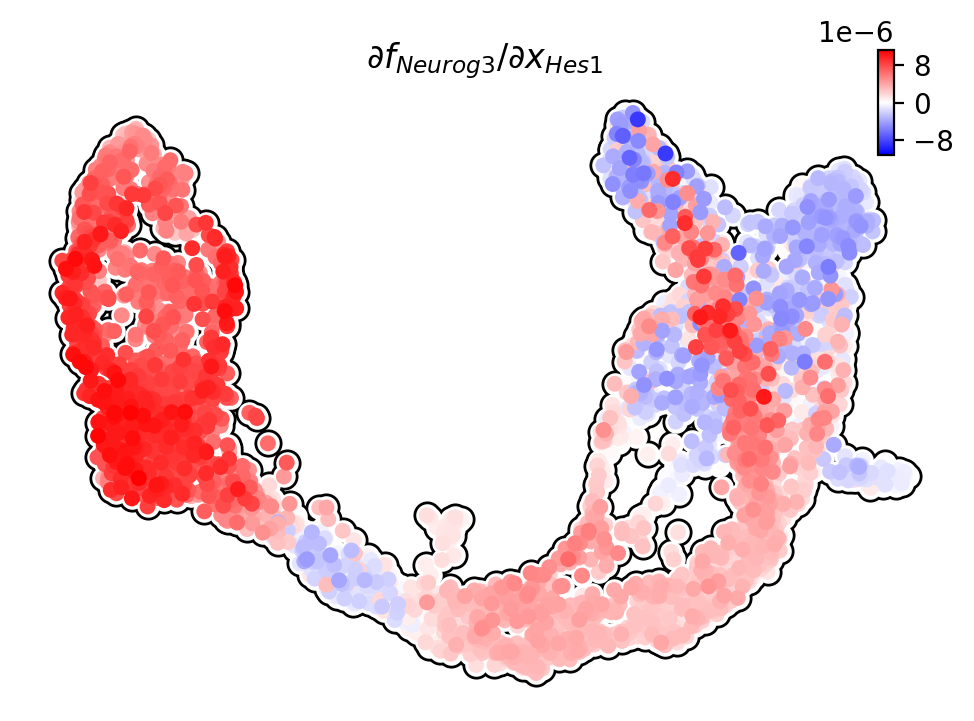

regulator: Hes1 effector: Pdx1


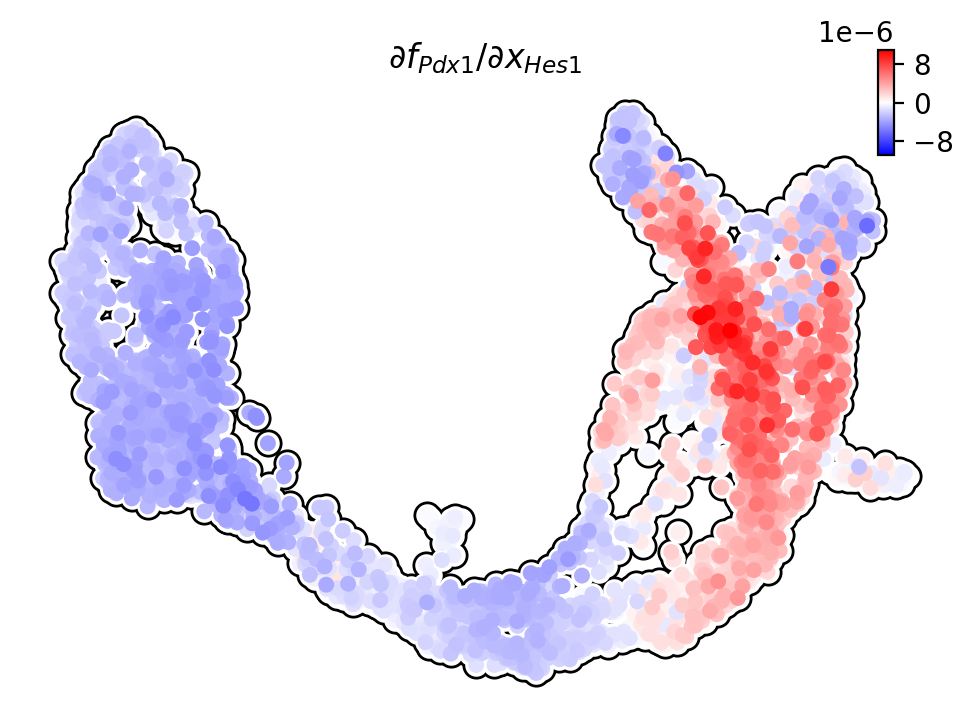

regulator: Neurog3 effector: Arx


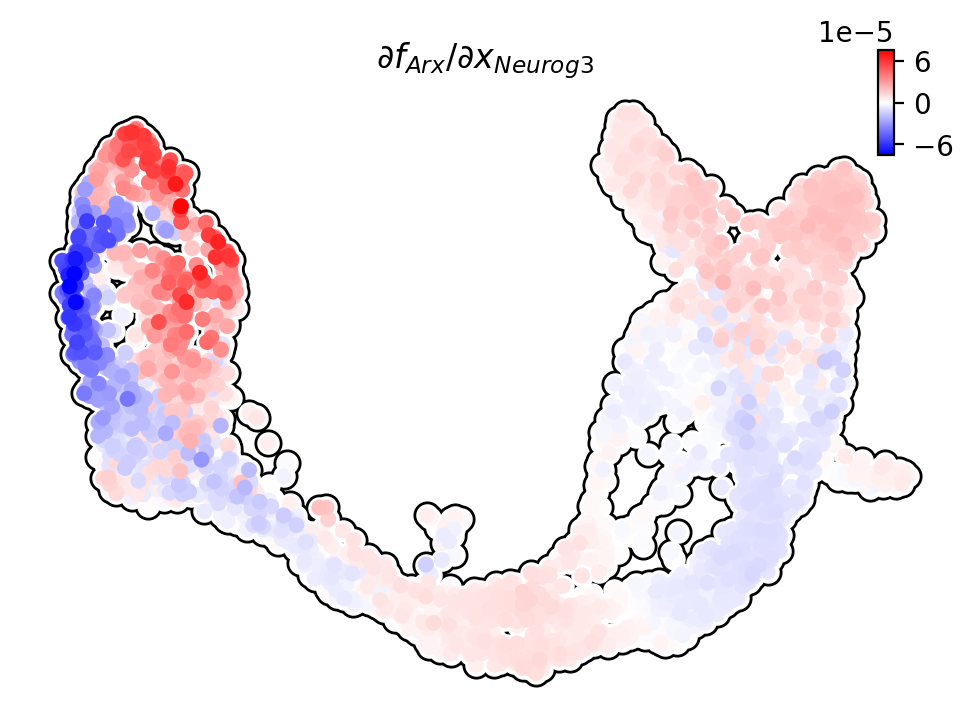

regulator: Neurog3 effector: Pax6


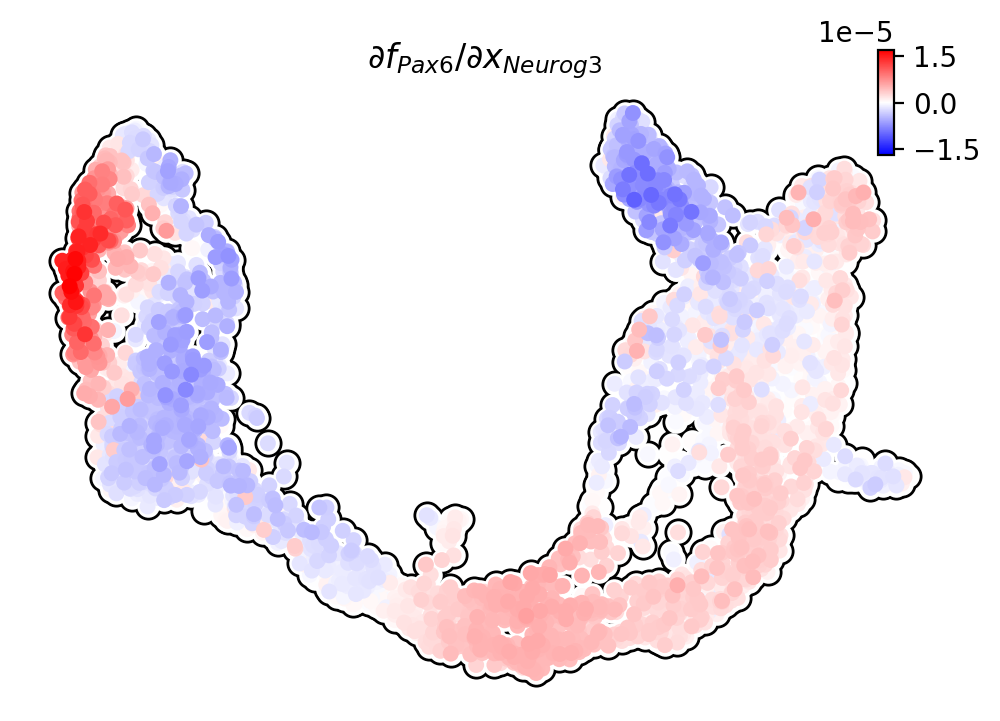

regulator: Neurog3 effector: Pax4


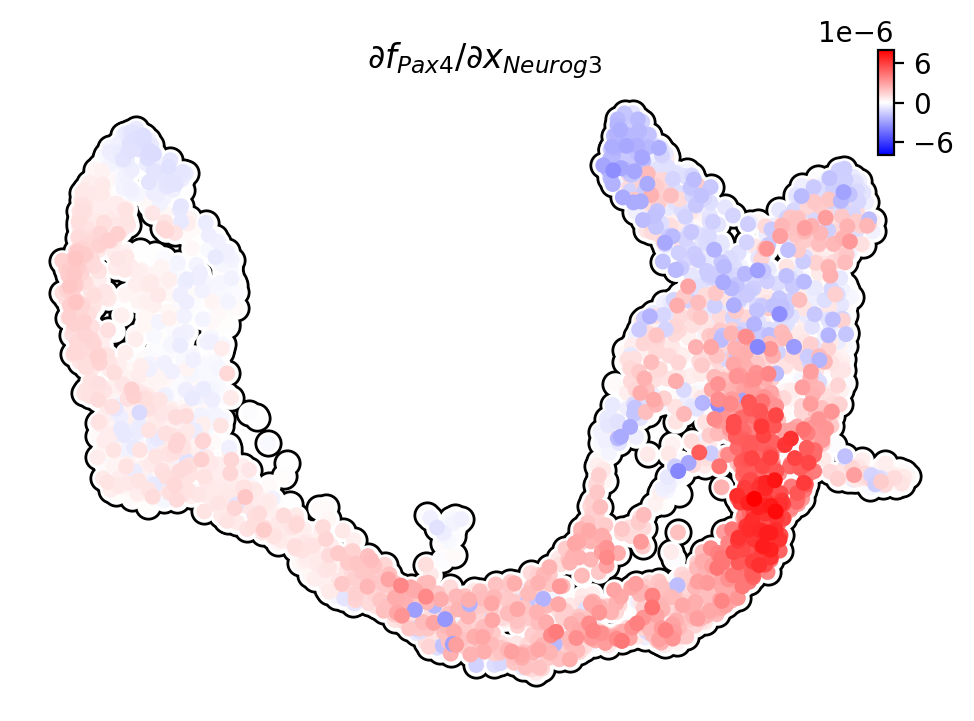

regulator: Neurog3 effector: Sox9


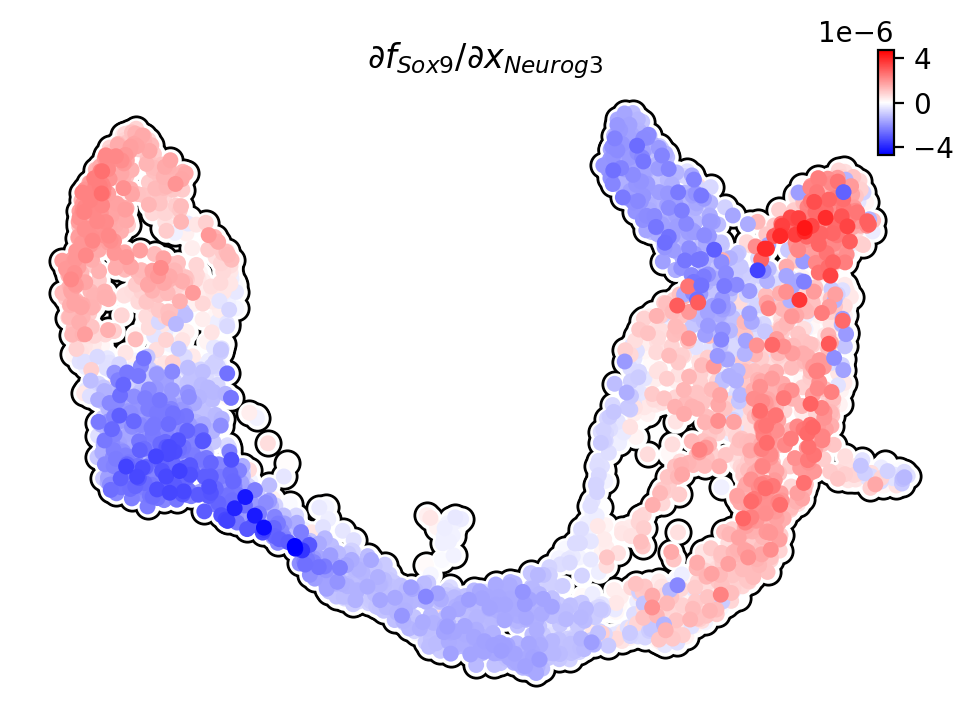

regulator: Neurog3 effector: Hes1


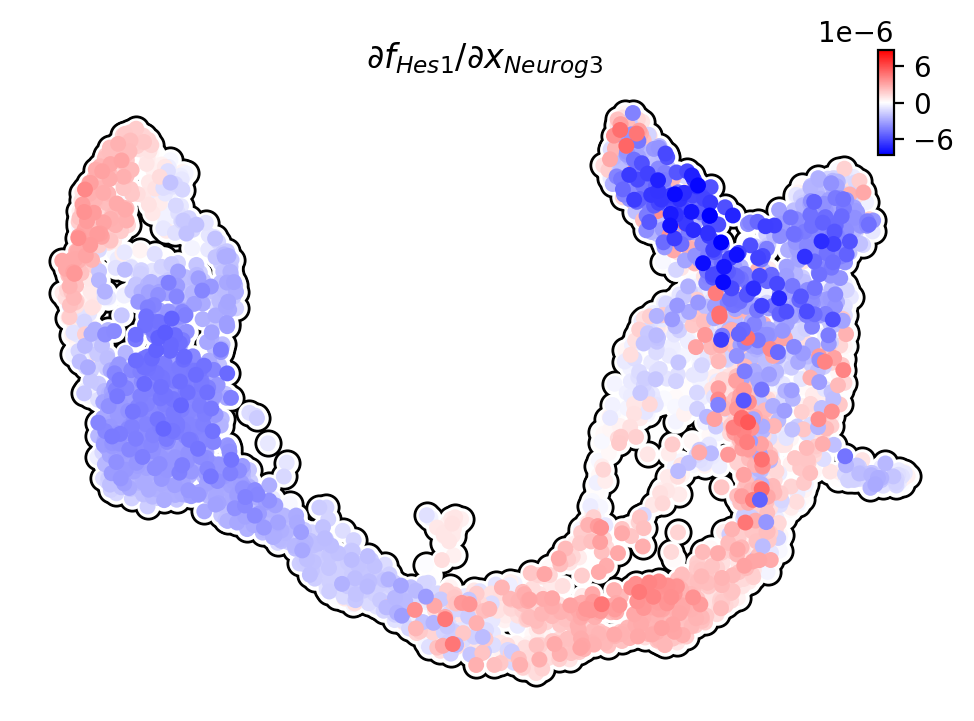

regulator: Neurog3 effector: Neurog3


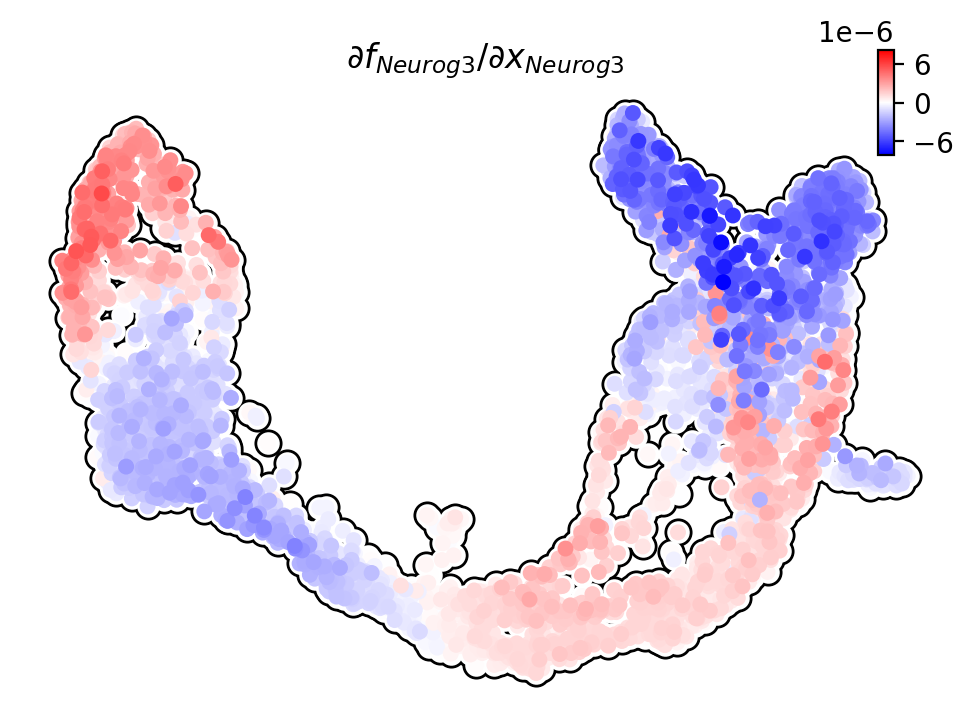

regulator: Neurog3 effector: Pdx1


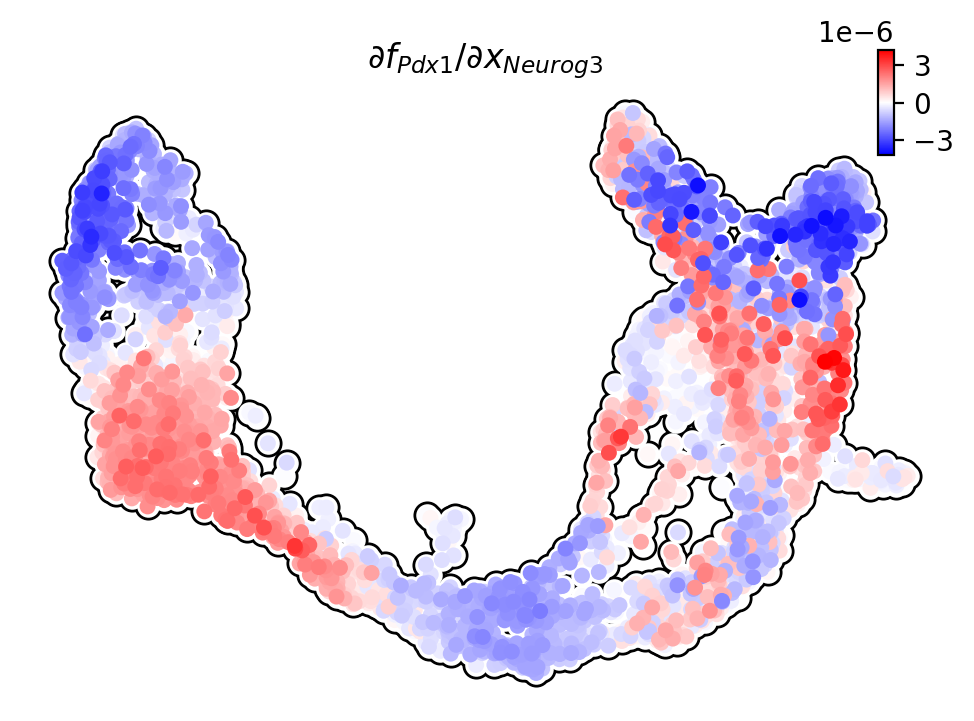

regulator: Pdx1 effector: Arx


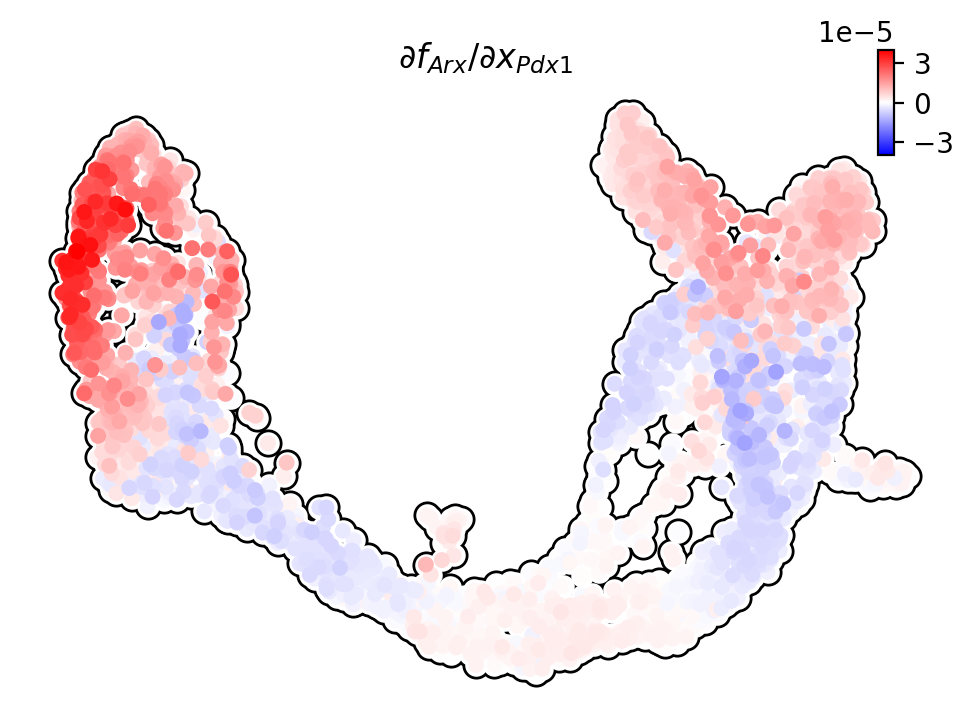

regulator: Pdx1 effector: Pax6


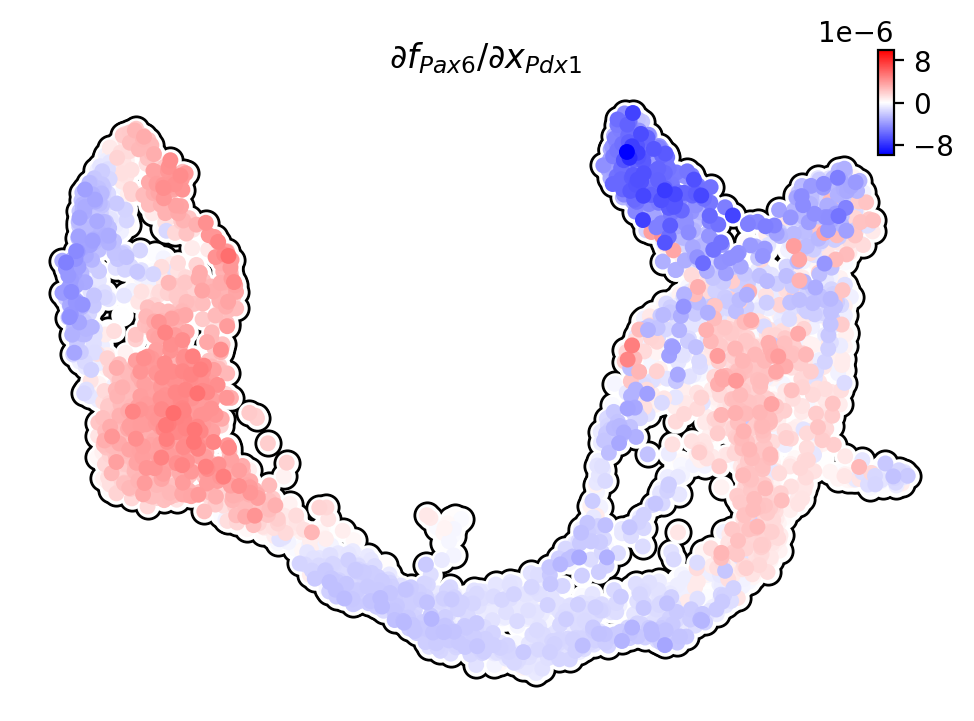

regulator: Pdx1 effector: Pax4


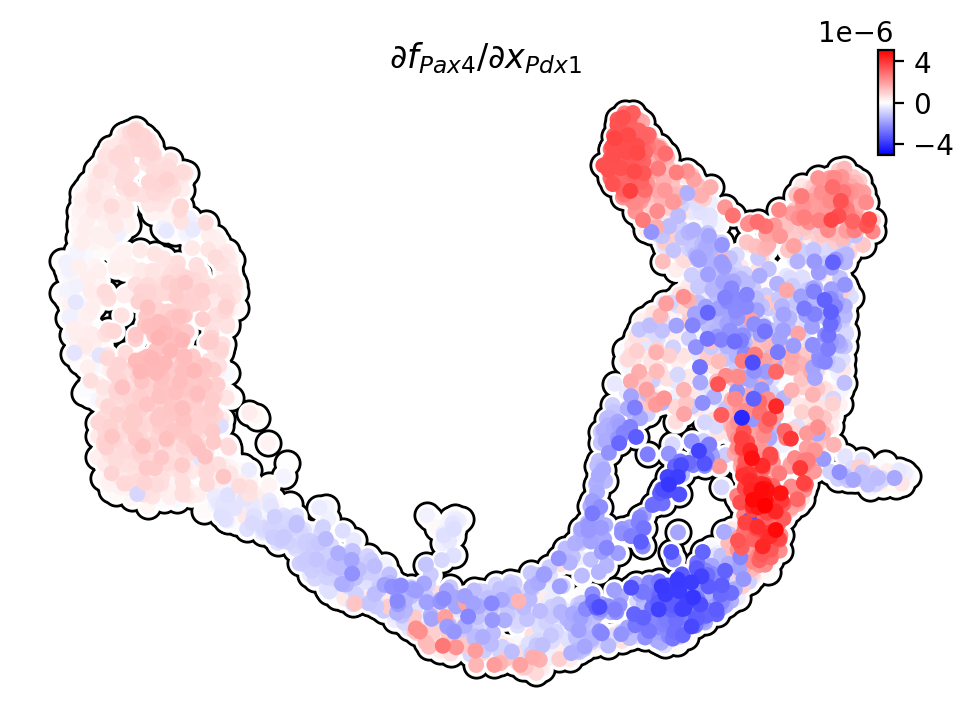

regulator: Pdx1 effector: Sox9


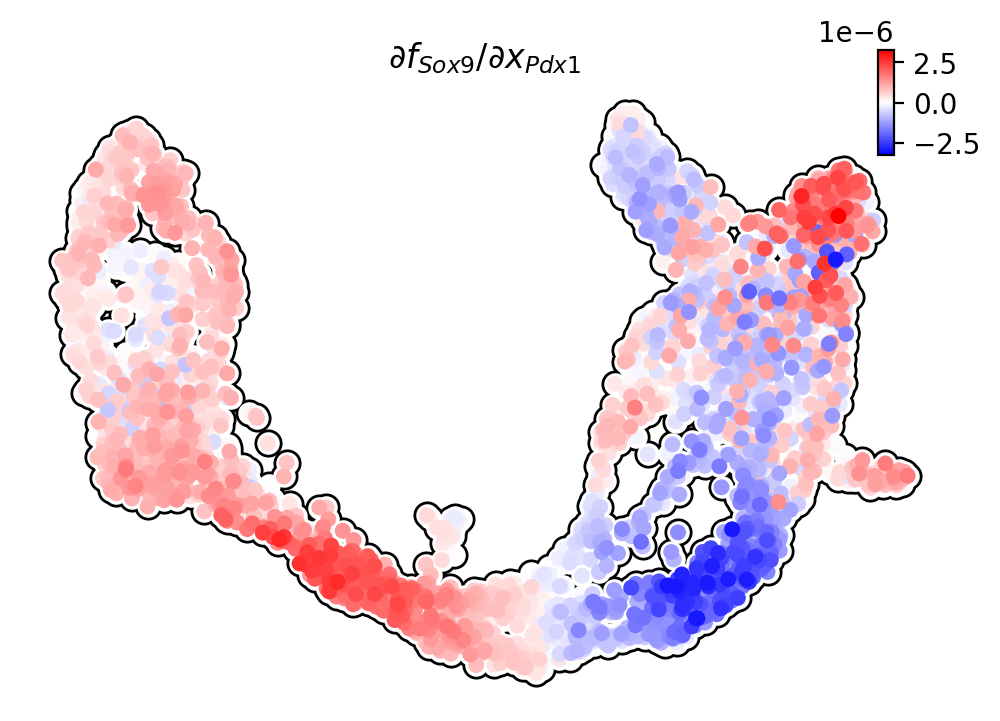

regulator: Pdx1 effector: Hes1


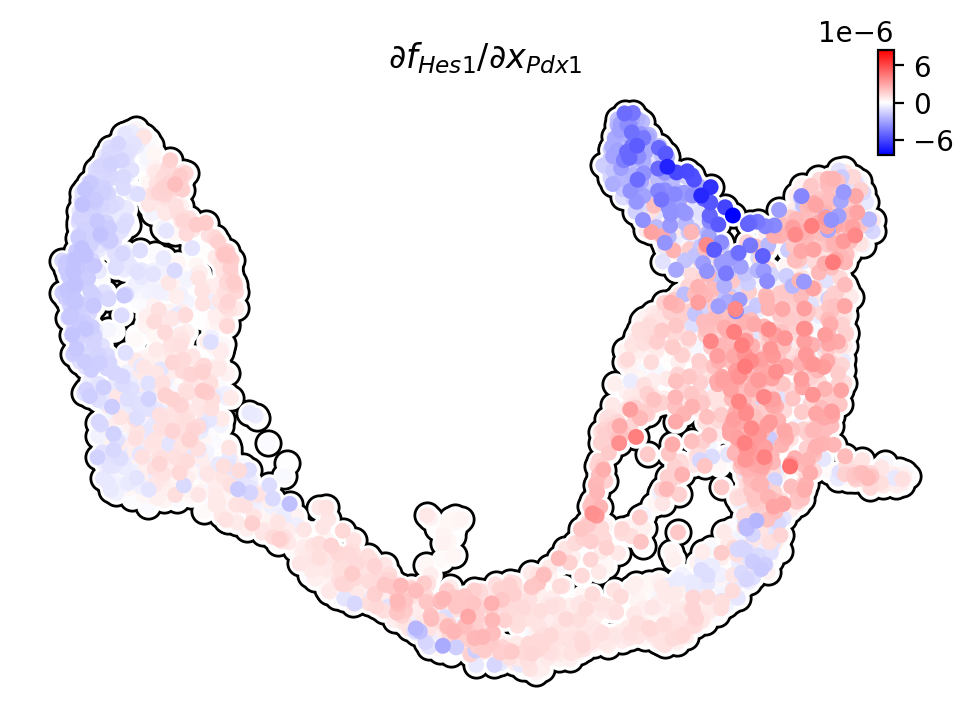

regulator: Pdx1 effector: Neurog3


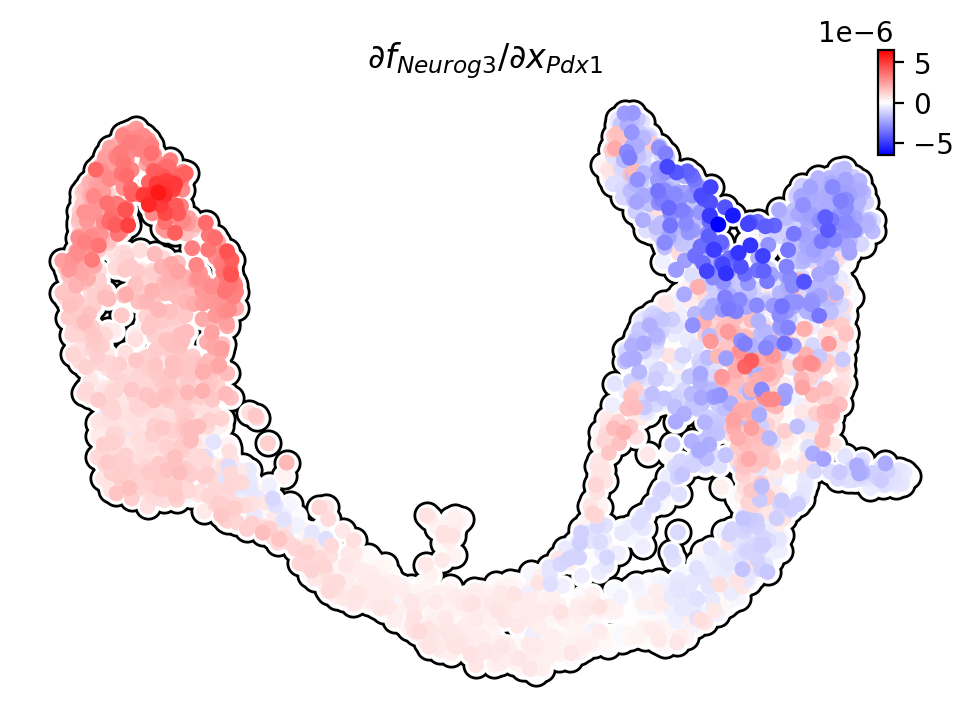

regulator: Pdx1 effector: Pdx1


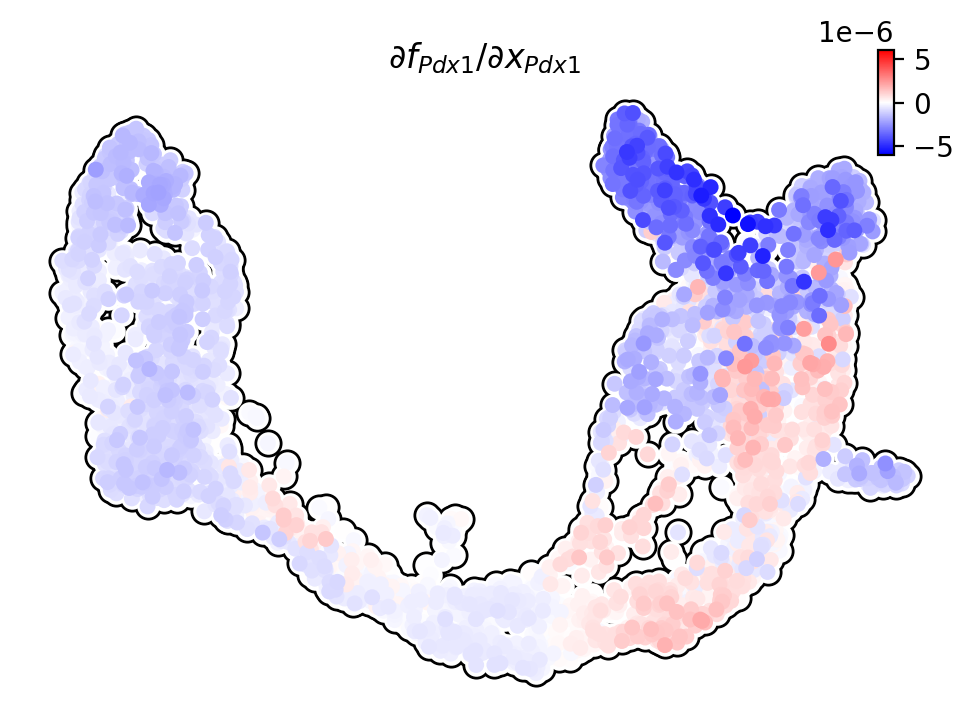

In [115]:
cluster2edges = dyn.vf.build_network_per_cluster(
    adata,
    cluster="clusters",
    cluster_names=None,
    full_reg_rank=full_reg_rank,
    full_eff_rank=full_eff_rank,
    genes=pancreas_genes,
    n_top_genes=100,
)

for reg in pancreas_genes:
    for eff in pancreas_genes:
        print('regulator:',reg,'effector:',eff)
        dyn.pl.jacobian(
            adata,
            basis="umap",
            regulators=[
                reg,
            ],
            effectors=[eff],
            alpha=1,
        )

|-----> [iterating reg_groups] in progress: 100.0000%
|-----> [iterating reg_groups] finished [0.2402s]


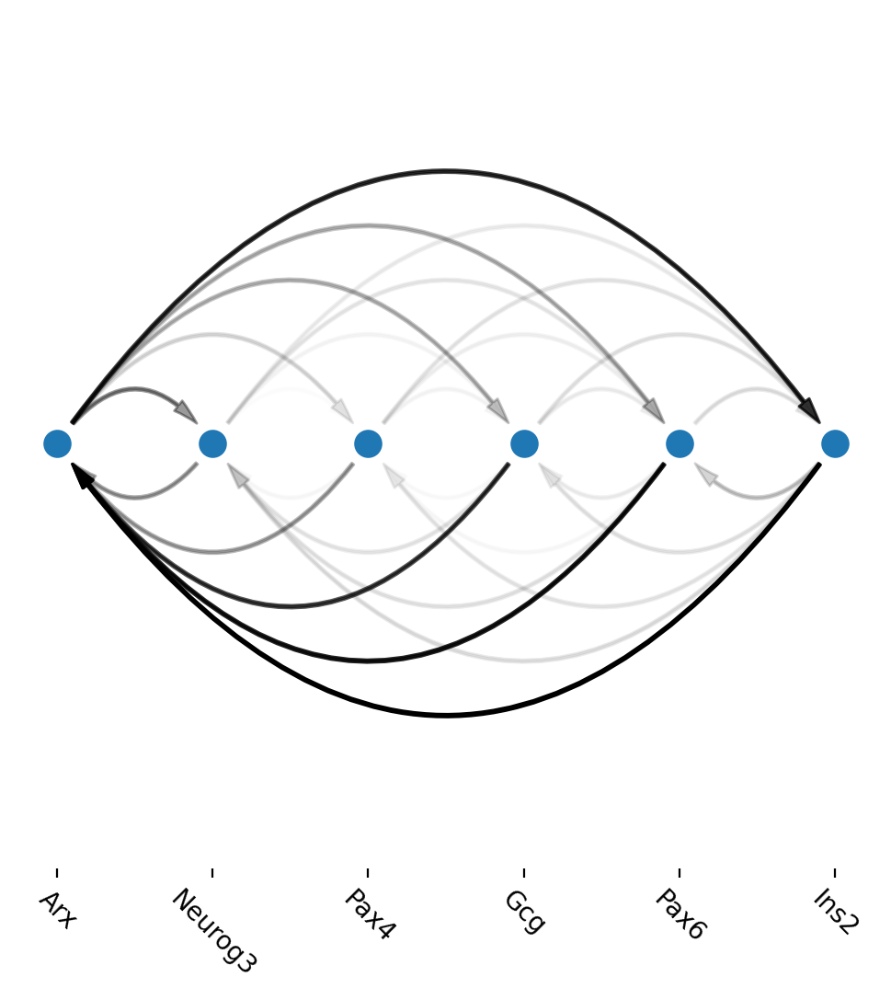

In [62]:
cell_type_regulators = ["Neurog3", "Arx", "Pax4", "Pax6", "Gcg", "Ins2", "Ss5", "Ghri"]
cluster2edges = dyn.vf.build_network_per_cluster(
    adata,
    cluster="clusters",
    cluster_names=None,
    full_reg_rank=full_reg_rank,
    full_eff_rank=full_eff_rank,
    genes=cell_type_regulators,
    n_top_genes=100,
)

import networkx as nx

network = nx.from_pandas_edgelist(
    cluster2edges["Ductal"], "regulator", "target", edge_attr="weight", create_using=nx.DiGraph()
)

ax = dyn.pl.arcPlot(
    adata, cluster="clusters", cluster_name="Ductal", edges_list=None, network=network, color=None
)  # color="M_s")

In [ ]:
cell_type_regulators = ["Neurog3", "Arx", "Pax4", "Pax6", "Gcg", "Ins2", "Ss5", "Ghri"]
cluster2edges = dyn.vf.build_network_per_cluster(
    adata,
    cluster="clusters",
    cluster_names=None,
    full_reg_rank=full_reg_rank,
    full_eff_rank=full_eff_rank,
    genes=cell_type_regulators,
    n_top_genes=100,
)

import networkx as nx

network = nx.from_pandas_edgelist(
    cluster2edges["Beta"], "regulator", "target", edge_attr="weight", create_using=nx.DiGraph()
)

ax = dyn.pl.arcPlot(
    adata, cluster="clusters", cluster_name="Beta", edges_list=None, network=network, color=None
)  # color="M_s")

In [24]:
dyn.pl.jacobian(
    adata,
    basis="umap",
    regulators=[
        "Pax6",
        "Ins2",
    ],
    effectors=["Pax6", "Ins2"],
    alpha=1,
    save_show_or_return='return'
)

GridSpec(2, 2)

In [26]:
adata_save=adata.copy()

del adata_save.uns["velocyto_SVR"]
del adata_save.uns["VecFld_umap"]

In [27]:
adata_save.write("pancreatic_endocrinogenesis_vecfld_2.h5ad")

In [28]:
import anndata as ann
adata_load=ann.read_h5ad('pancreatic_endocrinogenesis_vecfld_2.h5ad')

|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


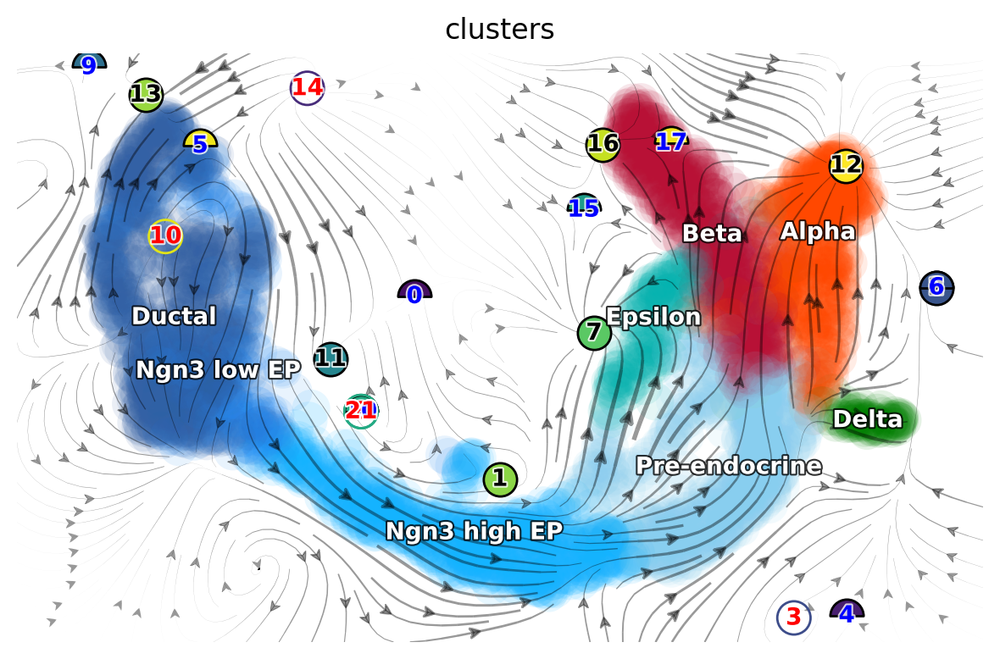

In [30]:
dyn.pl.topography(adata_load, color=['clusters'], basis='umap', background='white', 
                  streamline_color='black', color_key = pancreas_cluster_cmap, show_legend='on data')

In [32]:
adata_load_fix_points=adata_load.copy()
Xss, ftype, conf = adata_load_fix_points.uns['VecFld_umap']['Xss'],\
             adata_load_fix_points.uns['VecFld_umap']['ftype'],\
             adata_load_fix_points.uns['VecFld_umap']['confidence']
    
good_fixed_points = [10,7,16,12] # n=750

adata_load_fix_points.uns['VecFld_umap']['Xss'] = Xss[good_fixed_points]
adata_load_fix_points.uns['VecFld_umap']['ftype'] = ftype[good_fixed_points]
adata_load_fix_points.uns['VecFld_umap']['confidence']=conf[good_fixed_points]

|-----------> plotting with basis key=X_umap
|-----------> skip filtering clusters by stack threshold when stacking color because it is not a numeric type


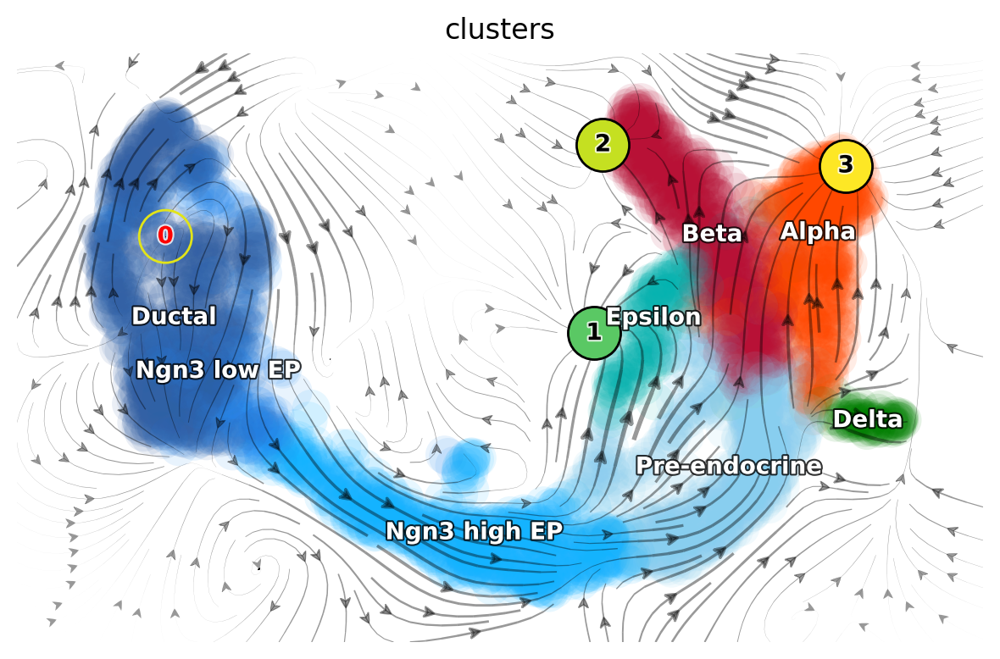

In [36]:
dyn.pl.topography(
    adata_load_fix_points,
    markersize=500,
    basis="umap",
    fps_basis="umap",
    color_key = pancreas_cluster_cmap, 
    # color=['pca_ddhodge_potential'],
    color=["clusters"],
    # marker_cmap=newcmp,
    # marker_cmap='rainbow',
    # show_legend=True,
    show_legend='on data',    
    save_show_or_return='show'
)